In [436]:
import math
import torch
import torch.nn as nn
import torch.utils
import torch.utils.data
from torchvision import datasets, transforms
from torch.autograd import Variable
import matplotlib.pyplot as plt 
import numpy as np
import scipy.io
from process_data_rnn_ssm import min_max_scaler,sliding_window
from sklearn import preprocessing
plt.rcParams.update({'font.size': 22})
import os, os.path
import pandas as pd
plt.rcParams["figure.figsize"] = (20,10)
from scipy import signal
from scipy.ndimage import gaussian_filter1d
from sklearn.preprocessing import StandardScaler, MinMaxScaler
plt.rcParams.update({'font.size': 22})
from scipy import signal
import scipy.stats as stats
plt.rcParams["figure.figsize"] = (20,10)
import mne
from mne.viz import plot_topomap
import pickle
from eeg_config import Config
from train_VRNN import decode_z


In [217]:
def scale_back(data,scalers):
    unscaled_data = np.zeros(data.shape)
    for i,row in enumerate(data):
        #print(i)
        row = row.reshape((1,int(row.shape[0]*row.shape[1])))
        unscaled_row = scalers[i].inverse_transform(row)
        unscaled_row = unscaled_row.reshape((768,64))
        unscaled_data[i] = unscaled_row
    return unscaled_data

def get_trial_per_participant(data,trials_per_participant):
    mean_per_p = np.zeros((19,768,64))
    for i, n in enumerate(trials_per_participant):
        prev = int(np.sum(trials_per_participant[0:i]))
        if n != 0:
            for j in range(int(n)):
                mean_per_p[i] +=data[j+prev]
            mean_per_p[i]/n
    return mean_per_p

(322, 768, 64)
322
0
1
(72, 1536)
(1, 768, 64)


<Figure size 1440x720 with 0 Axes>

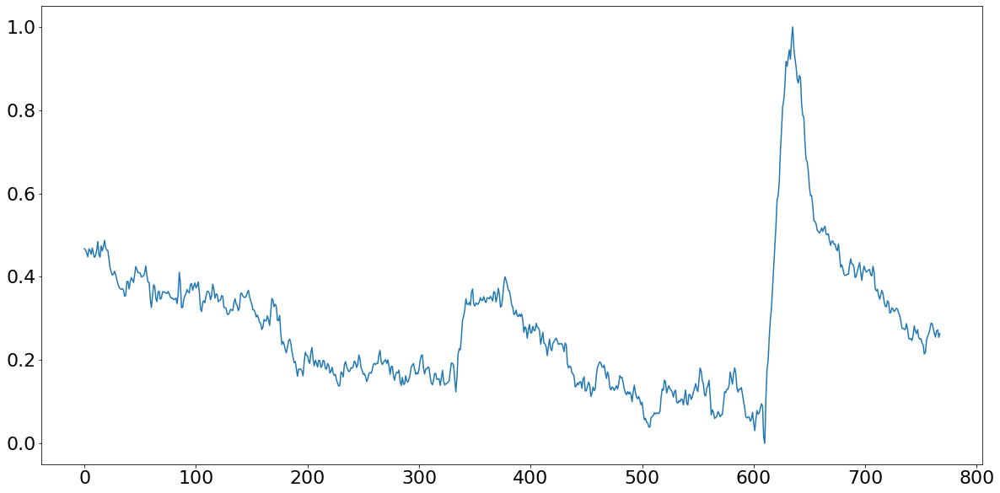

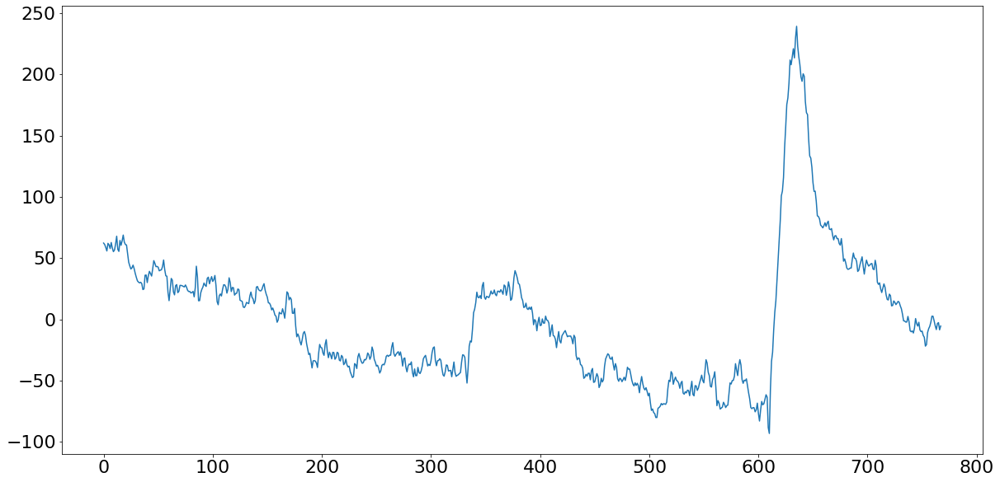

<Figure size 1440x720 with 0 Axes>

In [138]:
print(ple_data.shape)
#print(dis_data)
#print(ple_data)
#print(np.load("train_data_a.npy")[0])
plt.figure(1)
plt.plot(ple_data[0,:,1])
plt.figure(2)
print(len(train_ple_min_max_scalers))
unscaled = scale_back(ple_data[0:2],train_ple_min_max_scalers[0:2])
plt.plot(unscaled[0,:,1])
#plt.plot(dis_data[1,:,1])
exp_path='/Users/corytrevor/Documents/Skola/KTH/EE/Master/exjobb/Code/VRNNC/src/iravani_neuro_data/SL07_02/eeg_data_session_01.mat'
mat = scipy.io.loadmat(exp_path)
trials = mat['data_eeg'][0][0][1][0]
print(trials[0].shape)
plt.figure(2)
#plt.plot(trials[0][:,1])
trial = trials[0]
trial,scaler = pre_process_trial(trial,cols,w)
print(trial.shape)
plt.figure(3)
#plt.plot(trial[0,:,1])
#row = trial[0]
#row = row.reshape((1,int(row.shape[0]*row.shape[1])))
#unscaled_row = scaler.inverse_transform(row)
#unscaled_row = unscaled_row.reshape((768,64))
#plt.plot(unscaled_row[:,1])


In [132]:
mat = scipy.io.loadmat('iravani_neuro_data/SL07_02/eeg_data_session_01.mat')
trials = mat['data_eeg'][0][0][4][1][0][0]
ch_names = []
for arr in mat['data_eeg'][0][0][4]:
    ch_names.append(arr[0][0])
print(ch_names[0])

n_channels = 64
sampling_freq = 128  # in Hertz
info = mne.create_info(n_channels, sfreq=sampling_freq)
print(info)

#ch_names = [f'MEG{n:03}' for n in range(1, 10)] + ['EOG001']
ch_names = ch_names[0:64]
ch_types = ['eeg'] * 64
info = mne.create_info(ch_names, ch_types=ch_types, sfreq=sampling_freq)
print(info)
info.set_montage('biosemi64')

Fp1
<Info | 7 non-empty values
 bads: []
 ch_names: 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, ...
 chs: 64 MISC
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 64.0 Hz
 meas_date: unspecified
 nchan: 64
 projs: []
 sfreq: 128.0 Hz
>
<Info | 7 non-empty values
 bads: []
 ch_names: Fp1, AF7, AF3, F1, F3, F5, F7, FT7, FC5, FC3, FC1, C1, C3, C5, ...
 chs: 64 EEG
 custom_ref_applied: False
 highpass: 0.0 Hz
 lowpass: 64.0 Hz
 meas_date: unspecified
 nchan: 64
 projs: []
 sfreq: 128.0 Hz
>


<Info | 8 non-empty values
 bads: []
 ch_names: Fp1, AF7, AF3, F1, F3, F5, F7, FT7, FC5, FC3, FC1, C1, C3, C5, ...
 chs: 64 EEG
 custom_ref_applied: False
 dig: 67 items (3 Cardinal, 64 EEG)
 highpass: 0.0 Hz
 lowpass: 64.0 Hz
 meas_date: unspecified
 nchan: 64
 projs: []
 sfreq: 128.0 Hz
>

In [225]:
def pre_process_trial(trial,cols,w):
    trial = trial[0:64]
    #trial = trial[66:70]
    #print(trial.shape)
    #plt.plot(trial[1])
    #trial = trial.reshape((1536,cols))
    trial = trial.T
    #plt.plot(trial[:,1])
    #trial = gaussian_filter1d(trial,2.8)
    #trial = trial[100:-100]
    
    trial = trial[1::2]
    trial = trial.reshape((49152,1))
    #trial = trial.reshape((3072,1))
    scaler = MinMaxScaler()
    scaler.fit(trial)
    trial = scaler.transform(trial)
    trial = trial.reshape((768,cols))
    trial = sliding_window(trial,w=w)
    
    return trial,scaler

def extract_experiment(path,exp_name,cols,w,train_data,train_labels,dis_data,n_dis,count_diff_dis,dis_min_max_scalers,ple_data,n_ple,count_diff_ple,ple_min_max_scalers):
    full_path= path+"/"+exp_name
    #print(full_path)
    mat = scipy.io.loadmat(full_path)
    bias = 0
    trials = mat['data_eeg'][0][0][1][0]
    odours = mat['data_eeg'][0][0][5]
    if j == 0:
        bias = 0
    elif j == 1:
        bias = len(df[df.Chunks == 1])
    elif j == 2:
        bias = len(df[df.Chunks == 1]) + len(df[df.Chunks == 2])

    for k,trial in enumerate(trials):
        #trial = np.append(trial[4:7],trial[39:42],axis=0)
        #trial = np.append(trial[0:64],trial[66:70],axis=0)
        #trial = trial.reshape((1,w,cols))
        #print("k",k)
        #print(bias)
        if df.iloc[bias+k].Pleasantness <30:
            trial,scaler = pre_process_trial(trial, cols, w)
            #print(trial)
            dis_min_max_scalers.append(scaler)
            n_dis +=1
            labs = np.zeros(trial.shape[0])
            dis_data = np.append(dis_data,trial,axis=0)
            train_labels = np.append(train_labels,labs)
            train_data = np.append(train_data,trial,axis=0)
            count_diff_dis[odours[k]] +=1
            
        elif df.iloc[bias+k].Pleasantness > 77:
            trial,scaler = pre_process_trial(trial, cols, w)
            ple_min_max_scalers.append(scaler)
            n_ple +=1
            labs = np.ones(trial.shape[0])
            ple_data = np.append(ple_data,trial,axis=0)
            train_labels = np.append(train_labels,labs)
            train_data = np.append(train_data,trial,axis=0)
            count_diff_ple[odours[k]] +=1
    return train_data,train_labels,dis_data,n_dis,count_diff_dis,dis_min_max_scalers,ple_data,n_ple,count_diff_ple,ple_min_max_scalers

In [226]:
ground_path='/Users/corytrevor/Documents/Skola/KTH/EE/Master/exjobb/Code/VRNNC/src/iravani_neuro_data/'
dir_names = [name for name in os.listdir(ground_path) if name.startswith('SL') ]
print(dir_names)
dir_names.sort()
ind = 0
cols = 64
w = 768
train_labels = np.zeros(1)
train_data = np.zeros((1,w,cols))
ple_data = np.zeros((1,w,cols))
dis_data = np.zeros((1,w,cols))
test_labels = np.zeros(1)
test_data = np.zeros((1,w,cols))
ple_test_data = np.zeros((1,w,cols))
dis_test_data = np.zeros((1,w,cols))
trials_per_participant_ple = np.zeros(19)
trials_per_participant_dis = np.zeros(19)
count_diff_ple = np.zeros(33)
count_diff_dis = np.zeros(33)
trials_per_participant_ple_test = np.zeros(19)
trials_per_participant_dis_test = np.zeros(19)
count_diff_ple_test = np.zeros(33)
count_diff_dis_test = np.zeros(33)
train_ple_min_max_scalers = []
train_dis_min_max_scalers = []
test_ple_min_max_scalers = []
test_dis_min_max_scalers = []
for i, dir_name in enumerate(dir_names):

    path = ground_path+dir_name
    exp_names = os.listdir(path)
    exp_names.sort()
    #print(exp_names)
    df = pd.read_csv("iravani_neuro_data/table_"+str(i+1)+".csv")
    #print("i",i)
    n_ple = 0
    n_dis = 0
    n_ple_test = 0
    n_dis_test = 0
    #exp_scalers = []
    for j, exp_name in enumerate(exp_names):
        if j < 1 or j >1:
            train_data,train_labels,dis_data,n_dis,count_diff_dis,train_dis_min_max_scalers,ple_data,n_ple,count_diff_ple,train_ple_min_max_scalers = extract_experiment(path,exp_name,cols,w,train_data,train_labels,dis_data,n_dis,count_diff_dis,train_dis_min_max_scalers,ple_data,n_ple,count_diff_ple,train_ple_min_max_scalers)
            
            #exp_scalers.append(trial_scalers)

        else:
            test_data,test_labels,dis_test_data,n_dis_test,count_diff_dis_test,test_dis_min_max_scalers,ple_test_data,n_ple_test,count_diff_ple_test,test_ple_min_max_scalers = extract_experiment(path,exp_name,cols,w,test_data,test_labels,dis_test_data,n_dis_test,count_diff_dis_test,test_dis_min_max_scalers,ple_test_data,n_ple_test,count_diff_ple_test,test_ple_min_max_scalers)

    trials_per_participant_ple[i] = n_ple
    trials_per_participant_dis[i] = n_dis
    trials_per_participant_ple_test[i] =n_ple_test
    trials_per_participant_dis_test[i] =n_dis_test
    
train_data = train_data[1:]
train_labels = train_labels[1:]
ple_data = ple_data[1:]
dis_data = dis_data[1:]

test_data = test_data[1:]
test_labels = test_labels[1:]
ple_test_data = ple_test_data[1:]
dis_test_data = dis_test_data[1:]

['SL07_09', 'SL07_07', 'SL07_06', 'SL07_08', 'SL07_15', 'SL07_12', 'SL07_23', 'SL07_25', 'SL07_03', 'SL07_04', 'SL07_02', 'SL07_16', 'SL07_20', 'SL07_18', 'SL07_27', 'SL07_26', 'SL07_21', 'SL07_28', 'SL07_10']


In [167]:
print(np.sum(trials_per_participant_dis))
print(np.sum(trials_per_participant_ple))


292.0
304.0


In [510]:
print(ple_test_data.shape)
print(dis_test_data.shape)

(111, 768, 64)
(70, 768, 64)


In [308]:
with open('trials_per_participant_dis.npy', 'wb') as f:
    np.save(f,trials_per_participant_dis)
with open('trials_per_participant_ple.npy', 'wb') as f:
    np.save(f,trials_per_participant_ple)
    
with open('trials_per_participant_dis_test.npy', 'wb') as f:
    np.save(f,trials_per_participant_dis_test)
with open('trials_per_participant_ple_test.npy', 'wb') as f:
    np.save(f,trials_per_participant_ple_test)

In [171]:
with open('ple_data_256.npy', 'wb') as f:
    np.save(f,ple_data)
with open('dis_data_256.npy', 'wb') as f:
    np.save(f,dis_data)
    
with open('ple_test_data_256.npy', 'wb') as f:
    np.save(f,ple_test_data)
with open('dis_test_data_256.npy', 'wb') as f:
    np.save(f,dis_test_data)


In [172]:
  
with open('train_data_256.npy', 'wb') as f:
    np.save(f,train_data)
with open('train_labels_256.npy', 'wb') as f:
    np.save(f,train_labels)
with open('test_data_256.npy', 'wb') as f:
    np.save(f,test_data)
with open('test_labels_256.npy', 'wb') as f:
    np.save(f,test_labels)

In [487]:
with open('scalers_train_256.pickle', 'wb') as f:
    pickle.dump(train_ple_min_max_scalers, f)
    
with open('dis_test_scaler.pickle', 'wb') as f:
    pickle.dump(test_dis_min_max_scalers, f)

In [169]:
for i in range(2):
    train_data = np.append(train_data,train_data,axis=0)
    train_labels = np.append(train_labels,train_labels)

[ 0. 97. 96.  0. 33.  0.  0.  0. 32.  0.  0.  0.  0.  0.  0.  0. 38.  0.
  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  8.]
[32.0, 33.0, 10.0, 13.0, 22.0, 1.0]


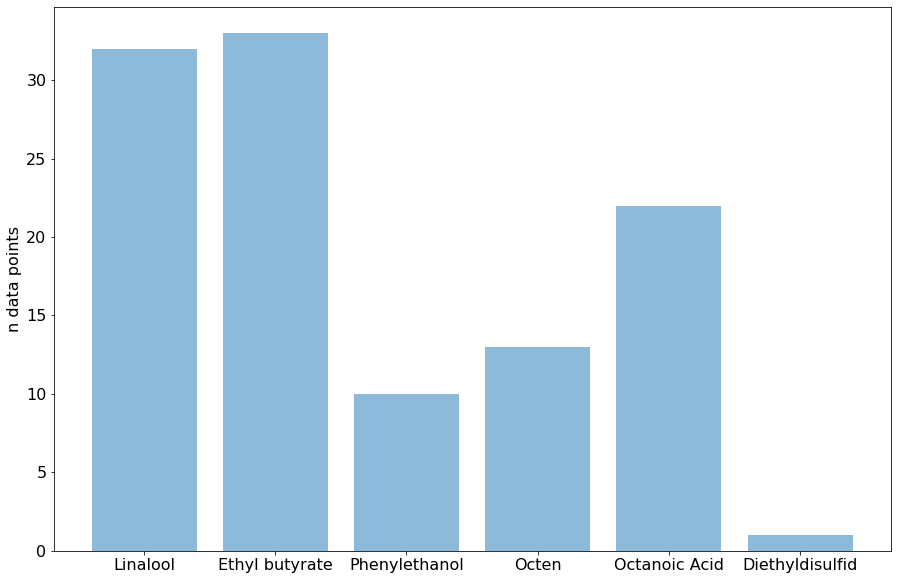

In [515]:
print(count_diff_ple)
arr = [count_diff_ple_test[1],count_diff_ple_test[2],count_diff_ple_test[4],count_diff_ple_test[8],count_diff_ple_test[16],count_diff_ple_test[32]]
print(arr)
plt.rcParams.update({'font.size': 16})
plt.figure(1)
plt.bar(np.arange(len(arr)), arr, align='center', alpha=0.5)

#plt.hist(arr, density=True, bins=6)
plt.ylabel('n data points')
plt.xticks(np.arange(len(arr)), ['Linalool','Ethyl butyrate','Phenylethanol','Octen','Octanoic Acid','Diethyldisulfid'])
#plt.xlabel("Odour");
plt.savefig("odour_distribution_ple_test.png")

[  0.   3.  20.   0.  26.   0.   0.   0.  47.   0.   0.   0.   0.   0.
   0.   0.  22.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0. 174.]
[3.0, 2.0, 1.0, 3.0, 5.0, 56.0]


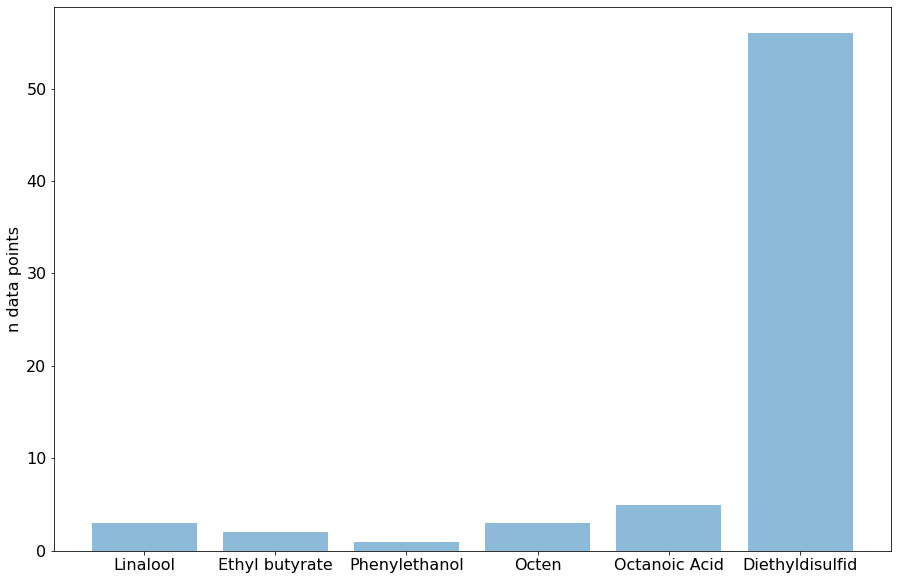

In [516]:
print(count_diff_dis)
arr = [count_diff_dis_test[1],count_diff_dis_test[2],count_diff_dis_test[4],count_diff_dis_test[8],count_diff_dis_test[16],count_diff_dis_test[32]]
print(arr)
plt.figure(1)
plt.bar(np.arange(len(arr)), arr, align='center', alpha=0.5)

#plt.hist(arr, density=True, bins=6)
plt.ylabel('n data points')
plt.xticks(np.arange(len(arr)), ['Linalool','Ethyl butyrate','Phenylethanol','Octen','Octanoic Acid','Diethyldisulfid'])
plt.savefig("odour_distribution_dis_test.png")

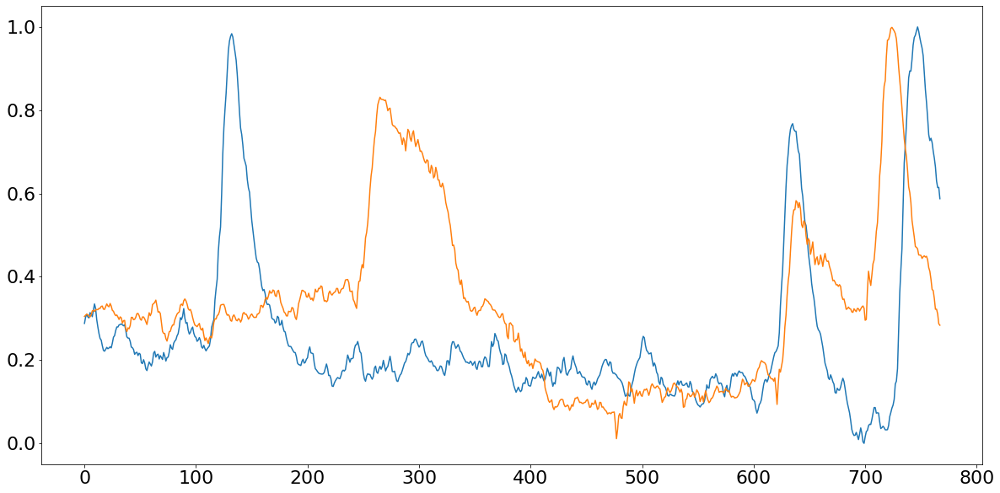

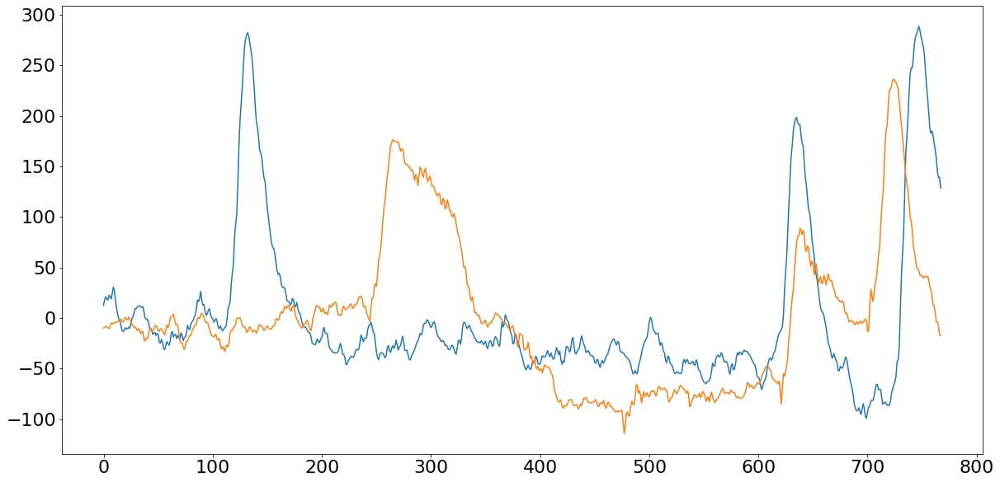

In [218]:
plt.figure(1)
plt.plot(ple_data[0,:,0])
plt.plot(dis_data[0,:,0])
plt.figure(2)
us_ple_data = scale_back(ple_data,train_ple_min_max_scalers)
us_dis_data = scale_back(dis_data,train_dis_min_max_scalers)
plt.plot(us_ple_data[0,:,0])
plt.plot(us_dis_data[0,:,0])

(2384, 768, 64)
(304, 768, 64)
304
0
1
(72, 1536)
(1, 768, 64)


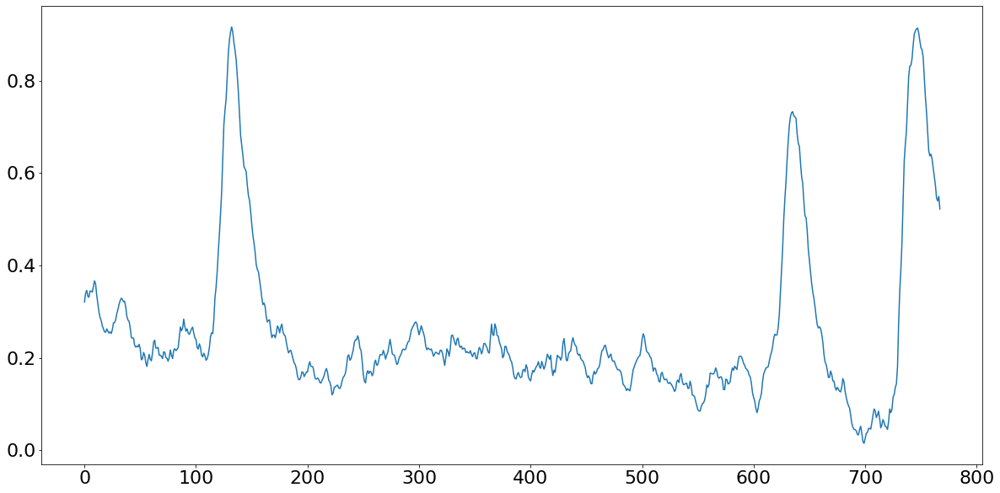

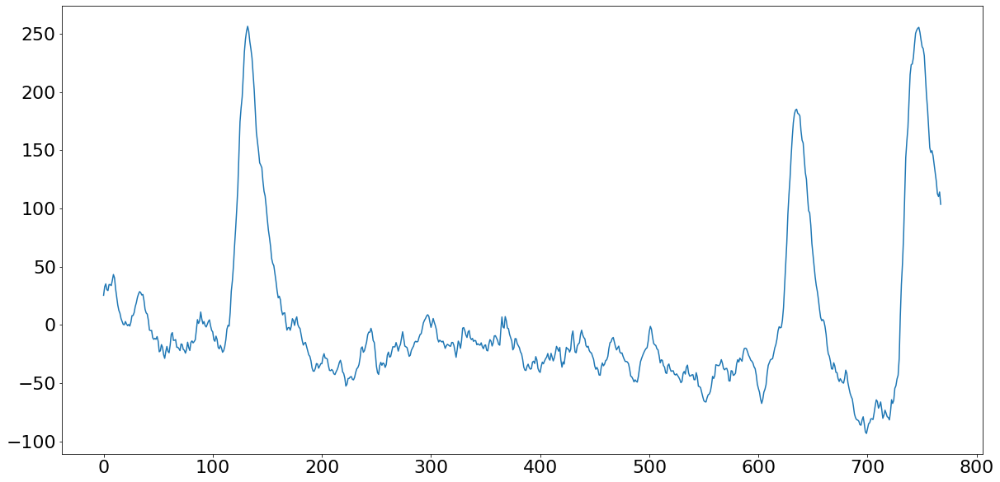

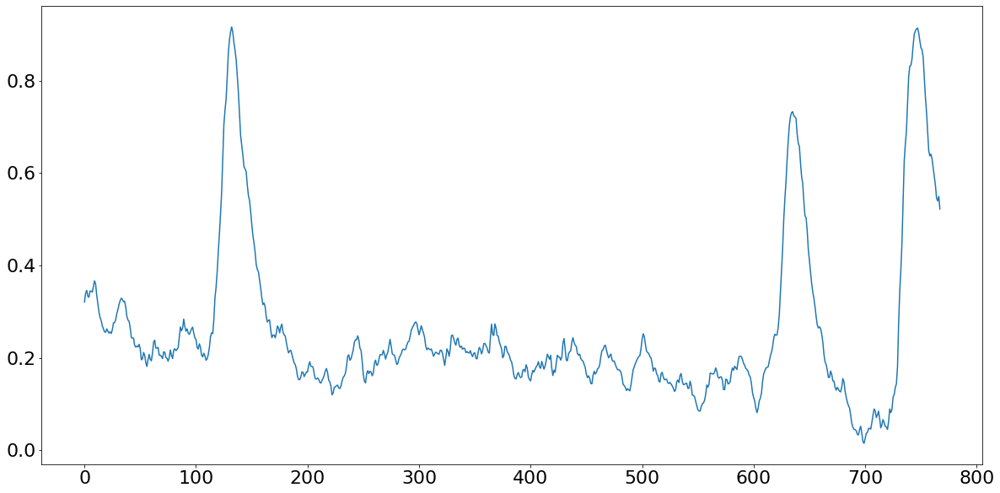

In [170]:


print(train_data.shape)
print(ple_data.shape)
#print(dis_data)
#print(ple_data)
#print(np.load("train_data_a.npy")[0])
plt.figure(1)
plt.plot(ple_data[0,:,1])
plt.figure(2)
print(len(train_ple_min_max_scalers))
unscaled = scale_back(ple_data[0:2],train_ple_min_max_scalers[0:2])
plt.plot(unscaled[0,:,1])
#plt.plot(dis_data[1,:,1])
exp_path='/Users/corytrevor/Documents/Skola/KTH/EE/Master/exjobb/Code/VRNNC/src/iravani_neuro_data/SL07_02/eeg_data_session_01.mat'
mat = scipy.io.loadmat(exp_path)
trials = mat['data_eeg'][0][0][1][0]
print(trials[0].shape)
plt.figure(2)
#plt.plot(trials[0][:,1])
trial = trials[0]
trial,scaler = pre_process_trial(trial,cols,w)
print(trial.shape)
plt.figure(3)
#plt.plot(trial[0,:,1])
#row = trial[0]
#row = row.reshape((1,int(row.shape[0]*row.shape[1])))
#unscaled_row = scaler.inverse_transform(row)
#unscaled_row = unscaled_row.reshape((768,64))
#plt.plot(unscaled_row[:,1])


# Prepare data

In [575]:
train =False
if train:
    synt_ple_data = np.load("synt_ple_data_16_10.npy")
    plt.plot(synt_ple_data[0,:,20])
    us_ple_data = scale_back(ple_data,train_ple_min_max_scalers)
    us_synt_ple_data = scale_back(synt_ple_data,train_ple_min_max_scalers)
    trials_ple = trials_per_participant_ple
    synt_dis_data = np.load("synt_dis_data_16_10.npy")
    us_dis_data = scale_back(dis_data,train_dis_min_max_scalers)
    us_synt_dis_data = scale_back(synt_dis_data,train_dis_min_max_scalers)
    trials_dis = trials_per_participant_dis
else:
    synt_ple_test_data = np.load("synt_ple_test_data_16_10.npy")
    us_ple_data = scale_back(ple_test_data,test_ple_min_max_scalers)
    us_synt_ple_data = scale_back(synt_ple_test_data,test_ple_min_max_scalers)
    trials_ple = trials_per_participant_ple_test
    synt_dis_test_data = np.load("synt_dis_test_data_16_10.npy")
    us_dis_data = scale_back(dis_test_data,test_dis_min_max_scalers)
    us_synt_dis_data = scale_back(synt_dis_test_data,test_dis_min_max_scalers)
    trials_dis = trials_per_participant_dis_test

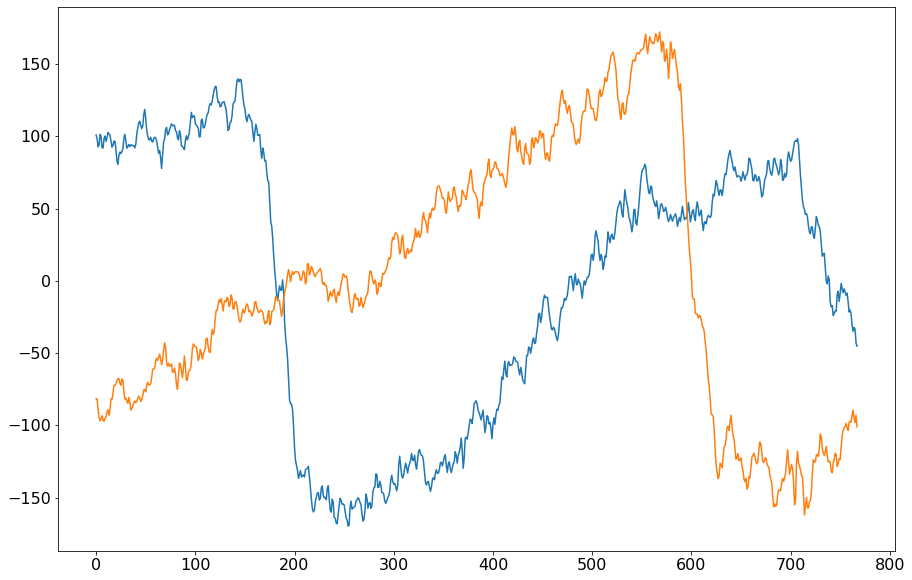

In [576]:
plt.plot(us_ple_data[0,:,0])
plt.plot(us_dis_data[0,:,0])

0.5943556461188868
0.6413431983561368
0.6917806990186273
0.909684697375809


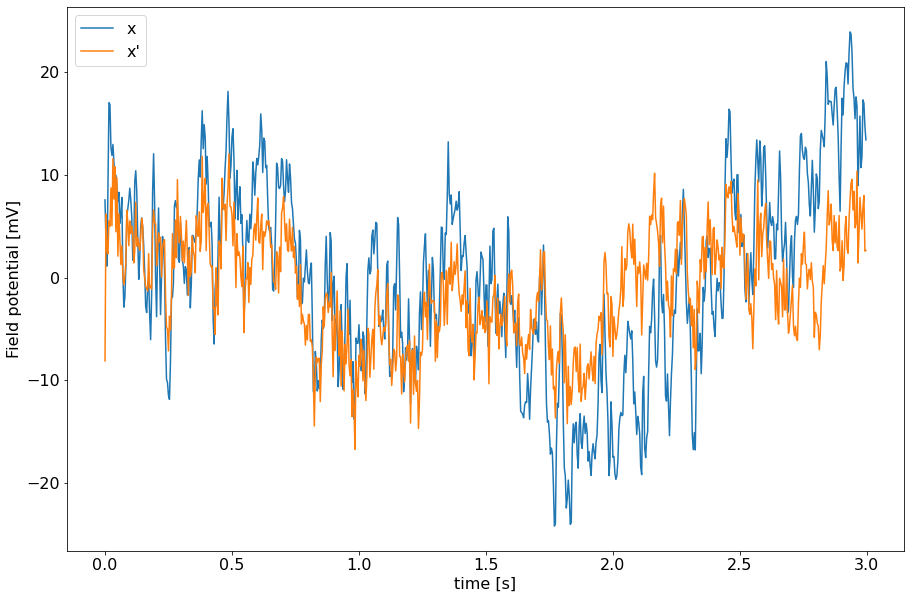

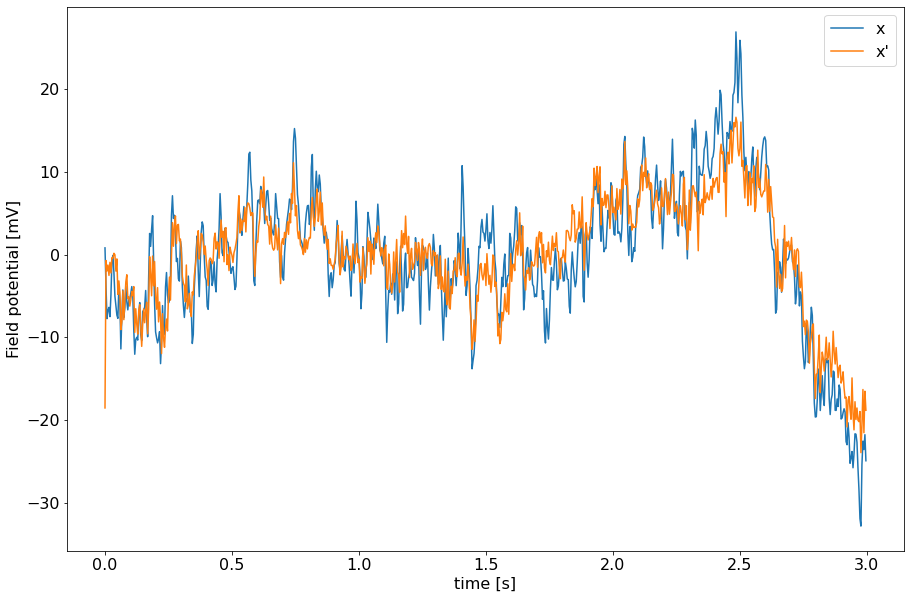

In [577]:
electrode = 4
plt.figure(1)
mean_ple = get_trial_per_participant(us_ple_data,trials_ple)

mean_synt_ple = get_trial_per_participant(us_synt_ple_data,trials_ple)
total_mean_ple = np.mean(mean_ple,axis=0)
total_mean_synt_ple = np.mean(mean_synt_ple,axis=0)
plt.plot(np.arange(0,3,1/256),total_mean_ple[:,electrode])
plt.plot(np.arange(0,3,1/256),total_mean_synt_ple[:,electrode])
plt.xlabel("time [s]")
plt.ylabel("Field potential [mV]")
plt.legend(["x","x'"])
plt.savefig("avg_x_ple_4_f3")
plt.figure(2)
mean_dis = get_trial_per_participant(us_dis_data,trials_dis)
mean_synt_dis = get_trial_per_participant(us_synt_dis_data,trials_dis)
total_mean_dis = np.mean(mean_dis,axis=0)
total_mean_synt_dis = np.mean(mean_synt_dis,axis=0)

plt.plot(np.arange(0,3,1/256),total_mean_dis[:,electrode])
plt.plot(np.arange(0,3,1/256),total_mean_synt_dis[:,electrode])
plt.xlabel("time [s]")
plt.ylabel("Field potential [mV]")
plt.legend(["x","x'"])
plt.savefig("avg_x_dis_4_f3")

corr_arr_ple = np.zeros(total_mean_ple.shape[1])
for i in range(total_mean_ple.shape[1]):
    r, p = stats.pearsonr(total_mean_synt_ple[:,i], total_mean_ple[:,i])
    corr_arr_ple[i] = r
print(np.mean(corr_arr_ple))
corr_arr_dis = np.zeros(total_mean_dis.shape[1])
for i in range(total_mean_dis.shape[1]):
    r, p = stats.pearsonr(total_mean_synt_dis[:,i], total_mean_dis[:,i])
    corr_arr_dis[i] = r
print(np.mean(corr_arr_dis))
corr_mat = corr_arr_ple.reshape((64,1))
print(corr_arr_ple[electrode])
print(corr_arr_dis[electrode])

In [565]:
print(corr_arr_dis)
print(np.argmax(corr_arr_dis))
print(corr_arr_dis[32])

[0.97708483 0.95484586 0.9718342  0.9695148  0.891153   0.97197341
 0.91508923 0.80433007 0.92913047 0.96053537 0.95326769 0.96054089
 0.9386948  0.90806329 0.6339539  0.80131046 0.89959676 0.96041265
 0.95873317 0.96926386 0.9652417  0.91672798 0.9213462  0.80645705
 0.92748219 0.94319594 0.89495614 0.72359809 0.92708358 0.92417251
 0.95232019 0.96686945 0.98751715 0.96613733 0.95797225 0.93391861
 0.98554894 0.96839764 0.96754646 0.93846381 0.94479709 0.8531618
 0.81574813 0.81092168 0.883455   0.88105348 0.93026041 0.95463687
 0.92399126 0.9197604  0.74426417 0.71392069 0.7768654  0.85271468
 0.93473299 0.95109675 0.69419378 0.56888155 0.90489449 0.84618417
 0.77273261 0.78259739 0.92553476 0.91253813]
32
0.9875171454075455


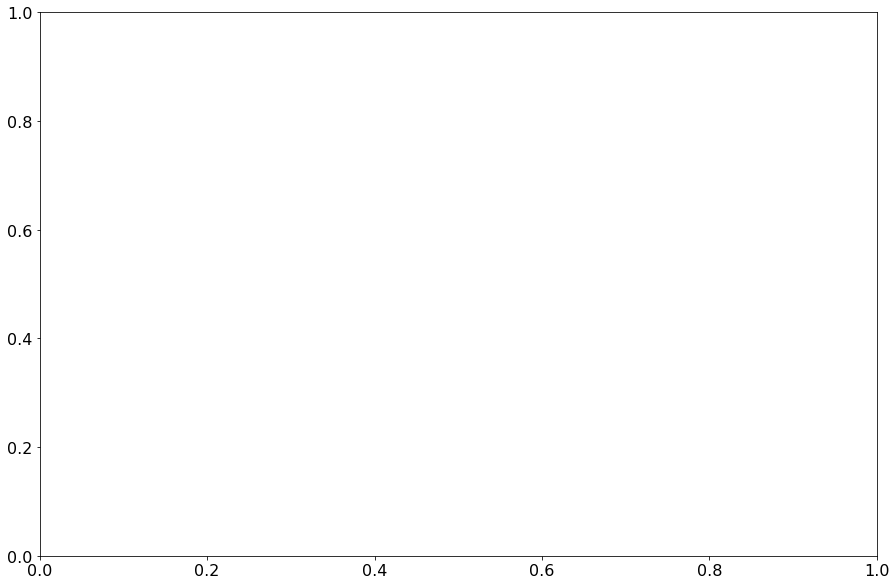

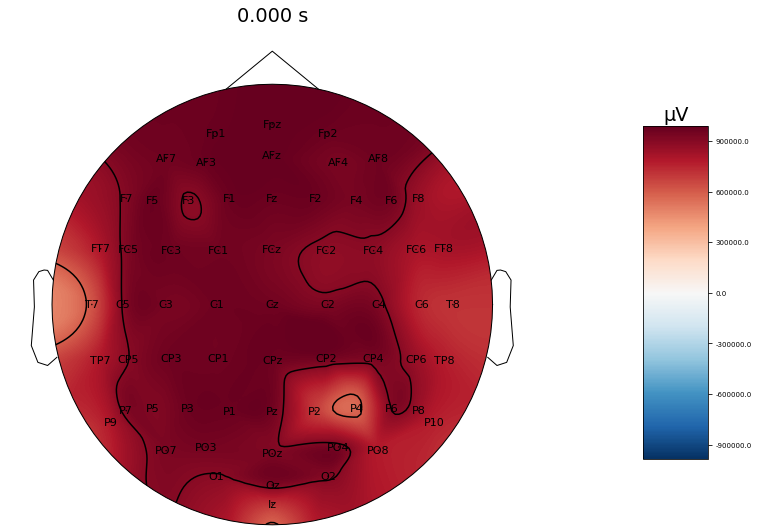

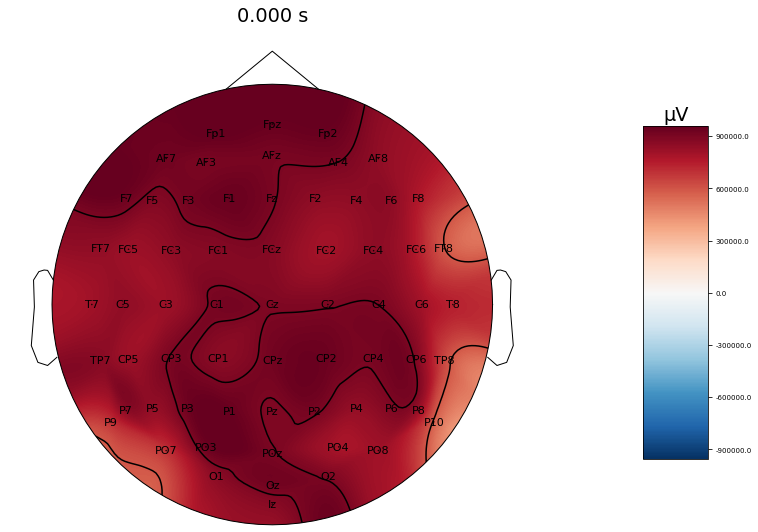

In [558]:
#print(corr_arr_dis)
#print(corr_arr_ple)
fig, main_ax = plt.subplots()
evoked_array = mne.EvokedArray(corr_arr_dis.reshape(len(corr_arr_dis),1), info, tmin=0,
                               nave=corr_mat.shape[0], comment='simulated')
fig = evoked_array.plot_topomap(0, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128,show=False,show_names=True)

plt.savefig("corr_avg_x_dis")
evoked_array = mne.EvokedArray(corr_arr_ple.reshape(len(corr_arr_ple),1), info, tmin=0,
                               nave=corr_mat.shape[0], comment='simulated')
fig = evoked_array.plot_topomap(0, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128,show=False,show_names=True)
plt.savefig("corr_avg_x_ple")                    

# Plot

<Evoked | 'simulated' (average, N=64), 0 – 5.9922 sec, baseline off, 64 ch, ~475 kB>


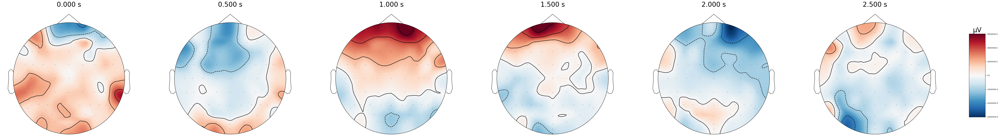

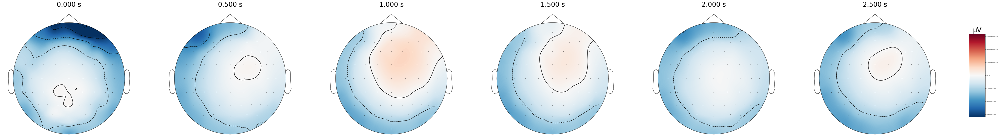

In [449]:
times = np.arange(0, 2.99, 0.5)

evoked_array = mne.EvokedArray((total_mean_ple).T, info, tmin=0,
                               nave=corr_mat.shape[0], comment='simulated')
fig = evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128,show=False)
plt.savefig("ple_brain_x")
evoked_array = mne.EvokedArray((total_mean_synt_ple).T, info, tmin=0,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128,show=False)
plt.savefig("ple_brain_synt_x")
print(evoked_array)

<Evoked | 'simulated' (average, N=64), 0 – 5.9922 sec, baseline off, 64 ch, ~475 kB>


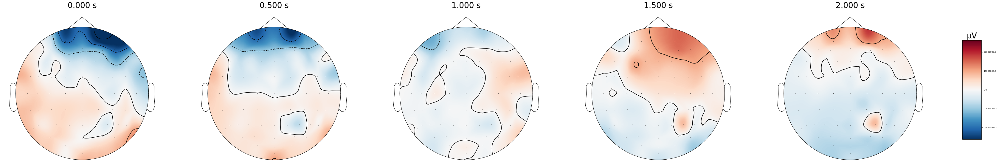

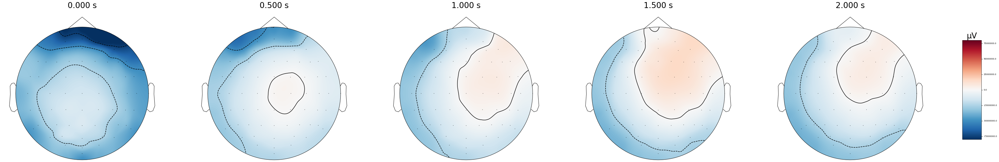

In [450]:
times = np.arange(0, 2.49, 0.5)
evoked_array = mne.EvokedArray((total_mean_dis).T, info, tmin=0,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128, show=False)
plt.savefig("dis_brain_x")
evoked_array = mne.EvokedArray((total_mean_synt_dis).T, info, tmin=0,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128,show=False)
plt.savefig("dis_brain_synt_x")
print(evoked_array)

In [336]:
evoked_array = mne.EvokedArray((total_mean_synt_dis).T, info, tmin=-0.5,
                               nave=corr_mat.shape[0], comment='simulated')
f = plot_topomap(data=evoked_array[0], ch_type='eeg',pos=evoked_array.info)
plt.colorbar(f)
plt.savefig("testing")

TypeError: 'EvokedArray' object does not support indexing

# Compare

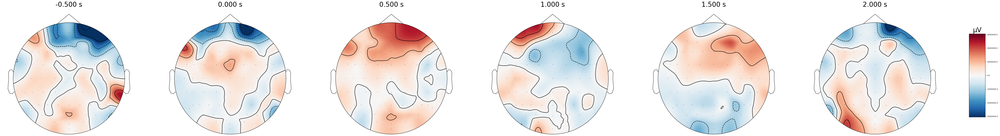

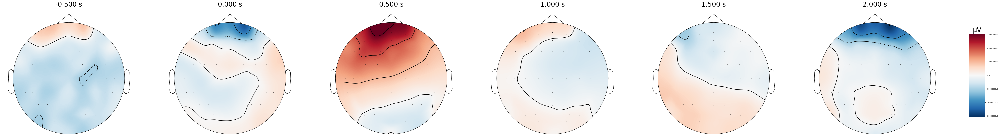

<Evoked | 'simulated' (average, N=64), -0.5 – 5.4922 sec, baseline off, 64 ch, ~475 kB>


In [307]:
times = np.arange(-0.5, 2.49, 0.5)
evoked_array = mne.EvokedArray((abs(total_mean_ple)-abs(total_mean_dis)).T, info, tmin=-0.5,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128)

evoked_array = mne.EvokedArray((abs(total_mean_synt_ple)-abs(total_mean_synt_dis)).T, info, tmin=-0.5,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128)
print(evoked_array)

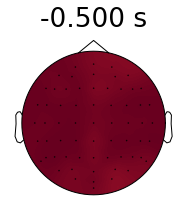

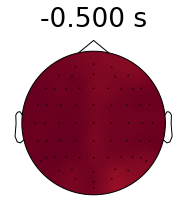

<Evoked | 'simulated' (average, N=64), -0.5 – -0.5 sec, baseline off, 64 ch, ~91 kB>


In [79]:

corr_mat = corr_arr_ple.reshape((64,1))

evoked_array = mne.EvokedArray(corr_mat, info, tmin=-0.5,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(-0.5, ch_type='eeg', time_unit='s',colorbar=False,
                    size=2, res=128)
corr_mat = corr_arr_dis.reshape((64,1))

evoked_array = mne.EvokedArray(corr_mat, info, tmin=-0.5,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(-0.5, ch_type='eeg', time_unit='s',colorbar=False,
                    size=2, res=128)
print(evoked_array)

# Fourier domain

/opt/anaconda3/envs/behavenet/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


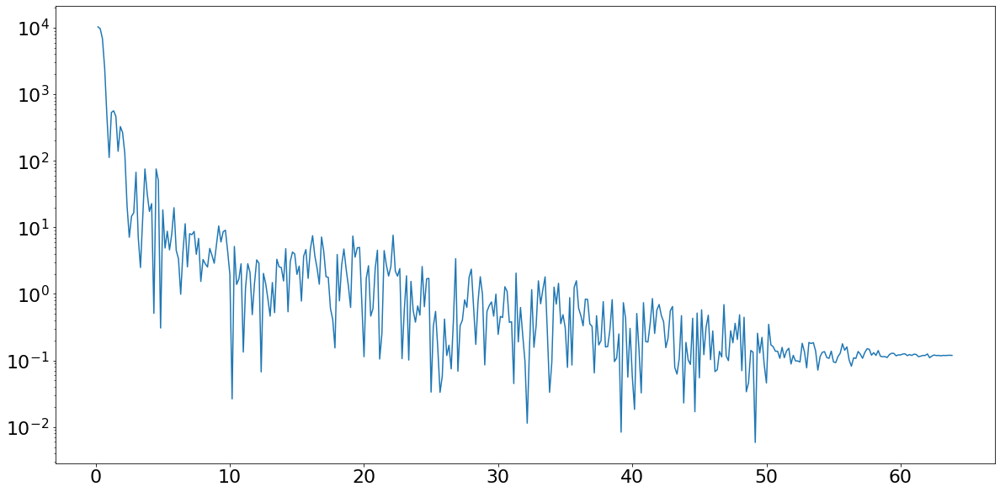

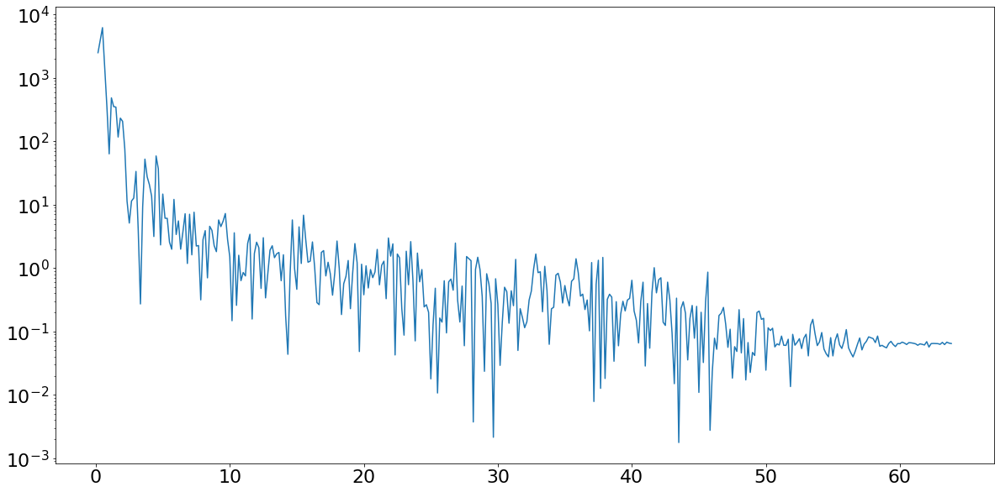

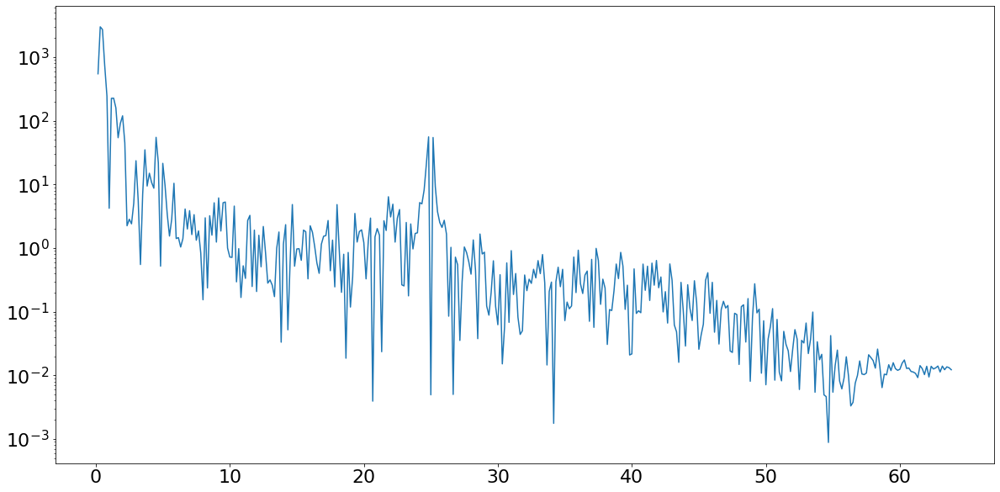

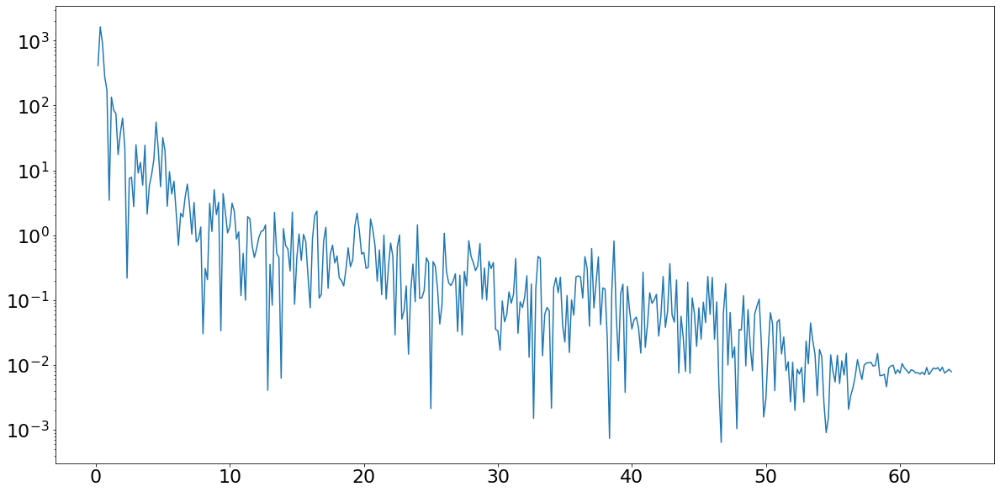

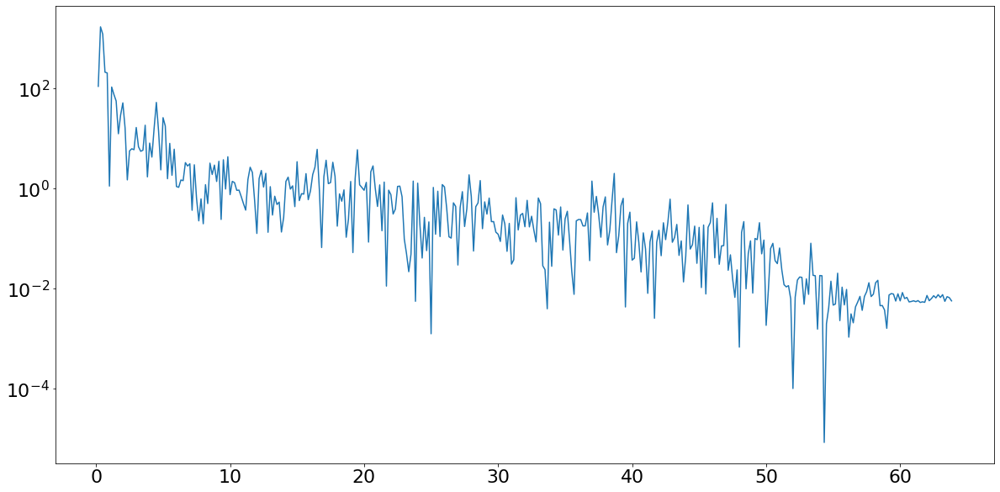

...

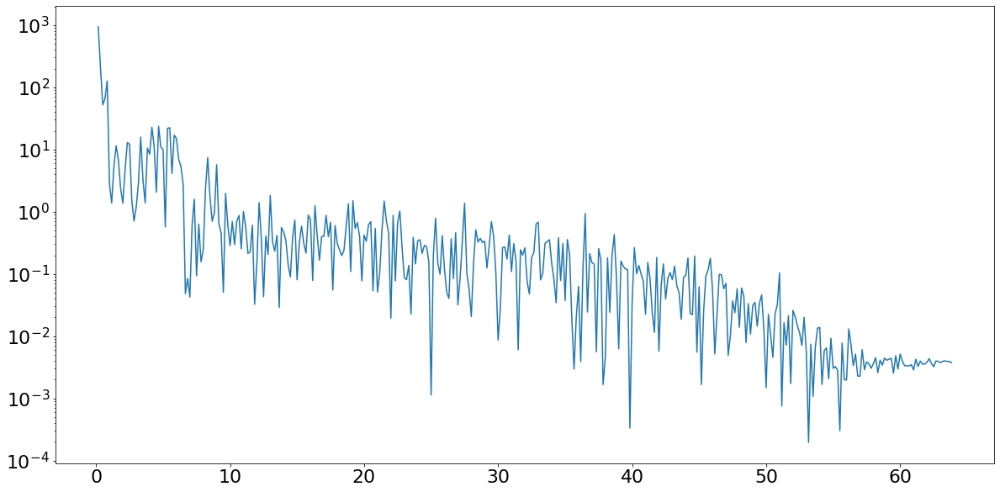

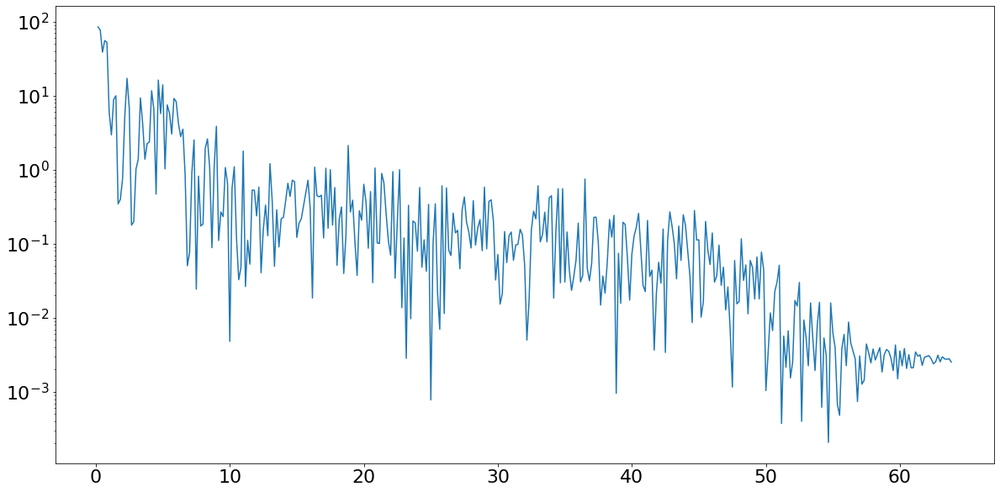

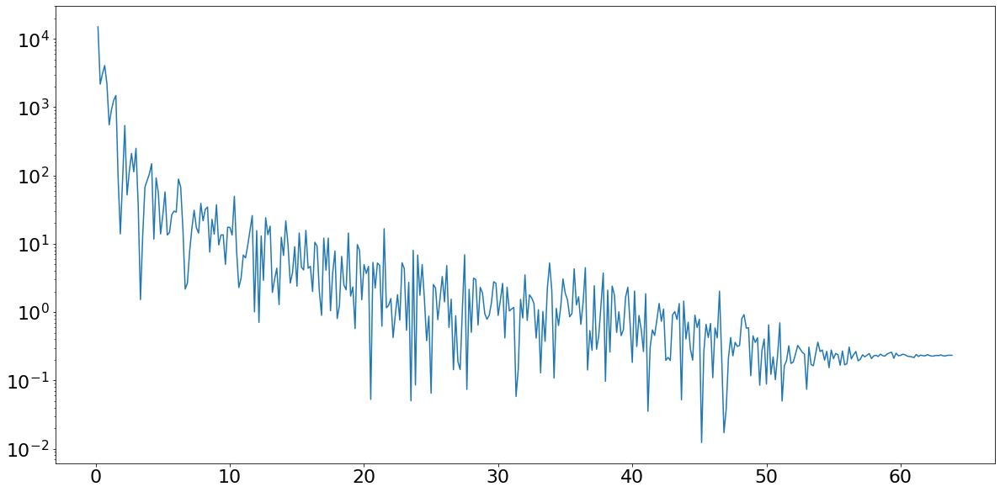

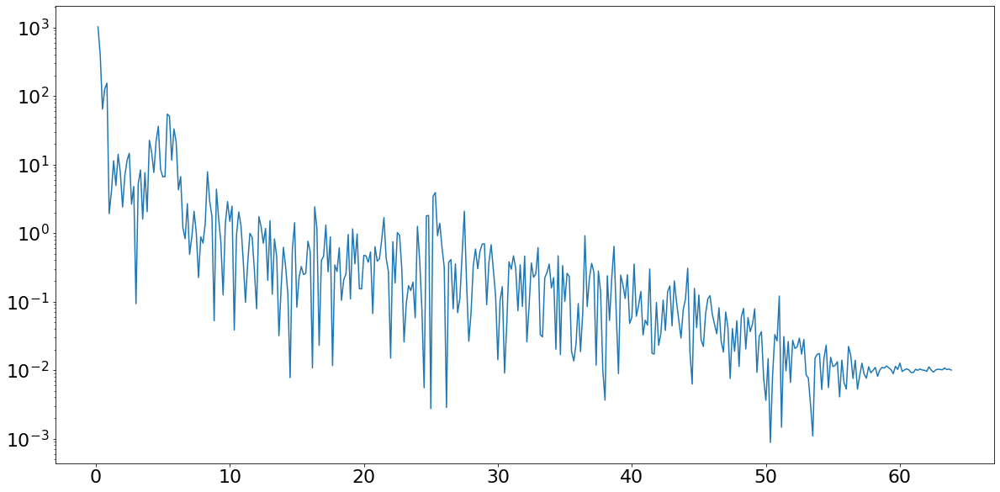

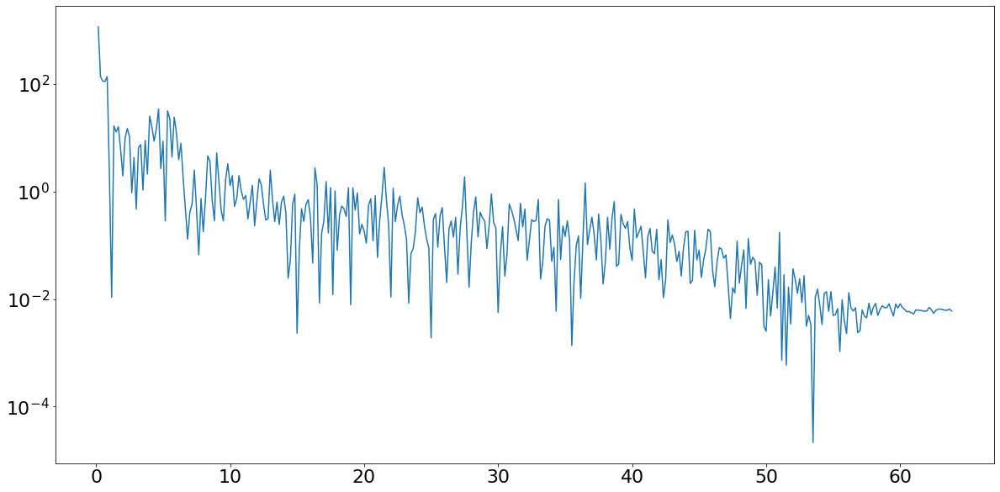

In [255]:
f_s=128
max_f_ple = np.zeros(total_mean_ple.shape[1])
for i in range(total_mean_ple.shape[1]):
    plt.figure(i)
    f, Pxx_den_dis = signal.periodogram(total_mean_ple[:,i], f_s)
    plt.semilogy(f[1:-1], Pxx_den_dis[1:-1])
    max_f = f[np.argmin(Pxx_den_dis[1:])]
    max_f_ple[i] = max_f
max_f_dis = np.zeros(total_mean_dis.shape[1])
for i in range(total_mean_dis.shape[1]):
    f, Pxx_den_dis = signal.periodogram(total_mean_dis[:,i], f_s)
    max_f = f[np.argmin(Pxx_den_dis[1:])]
    max_f_dis[i] = max_f

In [257]:
print(max_f_ple)
print(max_f_dis)

[49.         43.33333333 54.5        46.5        54.16666667 54.16666667
 52.16666667 63.83333333 24.83333333 24.83333333 57.33333333 41.
 53.33333333 57.16666667 63.83333333 48.16666667 52.66666667 50.
 46.5        53.33333333 53.33333333 53.33333333 55.83333333 53.83333333
 57.33333333 31.33333333 52.5        52.5        51.         50.16666667
 37.83333333 53.33333333 43.33333333 23.5        32.         36.
 38.83333333 38.83333333 61.33333333 58.33333333 54.33333333 55.66666667
 24.83333333 49.         47.5        24.83333333 24.83333333 53.33333333
 37.16666667 53.33333333 46.16666667 63.83333333 55.         53.33333333
 53.33333333 53.33333333 53.33333333 51.         53.33333333 53.
 54.5        45.         50.16666667 53.33333333]
[29.33333333 50.66666667 48.66666667 32.66666667 54.16666667 54.
 55.83333333 62.33333333 55.16666667 59.33333333 62.5        52.16666667
 62.16666667 63.83333333 49.66666667 55.         46.33333333 42.5
 51.33333333 12.5        48.33333333  3.16666667

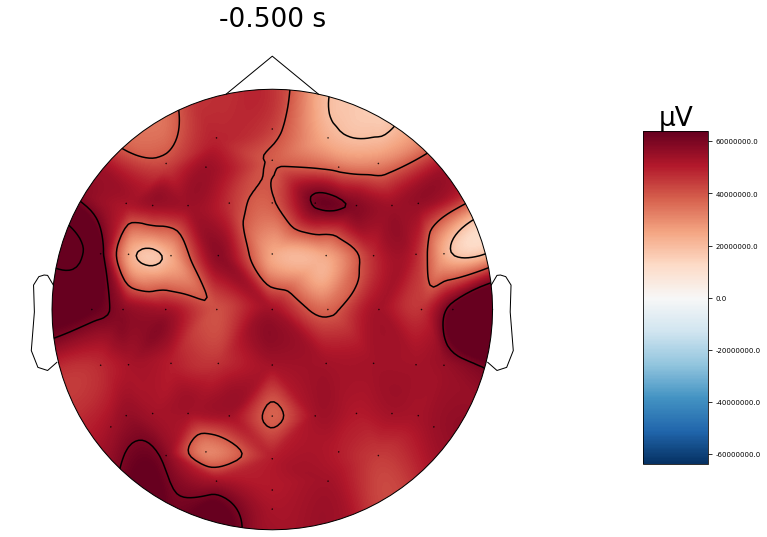

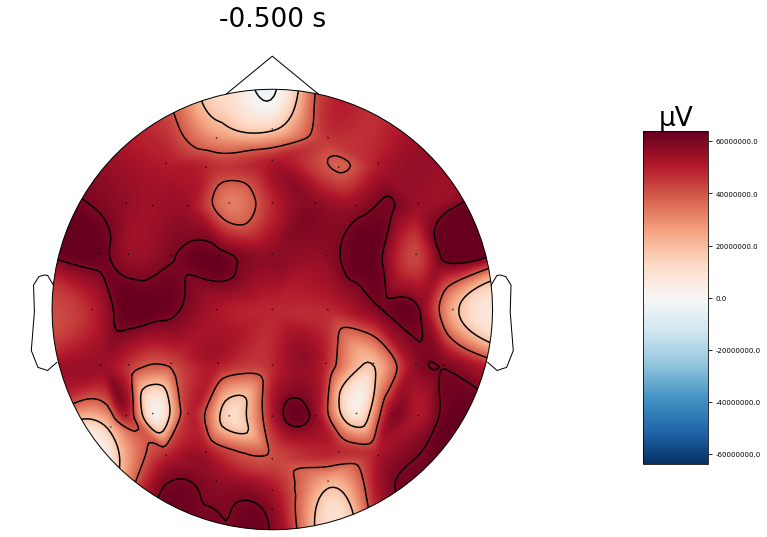

<Evoked | 'simulated' (average, N=64), -0.5 – -0.5 sec, baseline off, 64 ch, ~91 kB>


In [258]:
max_f_mat = max_f_ple.reshape((64,1))

evoked_array = mne.EvokedArray(max_f_mat, info, tmin=-0.5,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(-0.5, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128)
max_f_mat = max_f_dis.reshape((64,1))

evoked_array = mne.EvokedArray(max_f_mat, info, tmin=-0.5,
                               nave=corr_mat.shape[0], comment='simulated')
evoked_array.plot_topomap(-0.5, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128)
print(evoked_array)

# SVM

In [177]:
from sklearn import datasets, svm, metrics

In [178]:

#z_train = np.load("z_train.npy")[0:596]
#z_test = np.load("z_test.npy")
#print(z_test)
#z_train = train_data
print(z_train.shape)
print(z_test.shape)
z_train = z_train.reshape((596,int(384*16)))
z_test = z_test.reshape((181,int(384*16)))

(596, 384, 16)
(181, 384, 16)


In [180]:
print(test_labels)

print(train_data.shape)
print(test_labels.shape)
train_data_svm = train_data.reshape((596,int(768*4)))
test_data_svm = test_data.reshape((181,int(768*4)))

[0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 1.
 0. 0. 0. 1. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0.
 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1.
 0. 1. 1. 1. 0. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 0.
 1. 0. 0. 1. 1. 0. 0. 0. 1. 1. 1. 0. 1. 1. 0. 1. 0. 1. 1. 1. 0. 1. 1. 1.
 0. 1. 0. 1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 0. 0. 0. 0.
 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
(596, 768, 4)
(181,)


In [191]:
# Create a classifier: a support vector classifier
classifier = svm.SVC(gamma=0.01)
#fit to the trainin data
classifier.fit(train_data_svm,train_labels)

SVC(gamma=0.01)

In [192]:
y_pred = classifier.predict(test_data_svm)

In [193]:
print(np.sum(abs(y_pred-test_labels)))

86.0


In [184]:
print(len(test_labels[test_labels<1]))

70


In [532]:
print(train_labels)
print(test_labels)

[1. 0. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 0. 0. 0. 1.
 0. 1. 1. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0.
 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1.
 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 1. 0. 1. 0. 1. 0. 1.
 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 0. 1. 1. 1.
 0. 1. 1. 0. 1. 1. 1. 0. 1. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 0. 0. 0.
 1. 0. 0. 1. 0. 1. 0. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1.
 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 1. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 0. 1. 1. 1. 0. 1. 1.
 1. 1. 1. 1. 0. 1. 0. 1. 1. 1. 1. 1. 1. 0. 0. 1. 1.

# CONV CLASSIFIER

In [537]:
import torch
import torch.nn as nn
import torch.distributions.normal as Norm
import torch.distributions.kl as KL
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader
from torch import autograd
import torch.optim as optim
class Net(nn.Module):
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv1d(4, 4,32)
        self.pool = nn.MaxPool1d(2)
        self.conv2 = nn.Conv1d(4, 2, 16)
        self.m = nn.BatchNorm1d(100)
        self.fc1 = nn.Linear(352, 16)
        self.fc2 = nn.Linear(16, 2)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.conv2(x)))
        
        #print(x.shape)
        x = torch.flatten(x,1)
        x = F.relu(self.fc1(x))
        x = self.fc2(x)
        #print(x.shape)
        output = F.log_softmax(x, dim=1)
        #print(output.shape)
        return output
seed = 2021
train_test_ratio = 10
#train_data = all_data[:-1500]
#train_labels = all_labels[:-1500]
"""
n = int(train_data.shape[0]/train_test_ratio)
test_data = np.zeros((n,w,cols))
test_labels = np.zeros(n)
for i in range(0,n):
    index = np.random.randint(0,train_data.shape[0])
    e = train_data[index]
    l = train_labels[index]
    train_data = np.delete(train_data,index,axis=0)
    train_labels = np.delete(train_labels,index)
    #print(train_labels.shape)
    test_data[i] = e
    test_labels[i] = l
"""

ground_path='/Users/corytrevor/Documents/Skola/KTH/EE/Master/exjobb/Code/VRNNC'
zdt = np.load("z_dis_4_100.npy")
zpt = np.load("z_ple_4_100.npy")
z_train = np.append(zdt,zpt,axis=0)
t = np.append(np.ones(zdt.shape[0]),np.zeros(zpt.shape[0]))

zd = np.load("z_dis_test_4_100.npy")
zp = np.load("z_ple_test_4_100.npy")
z_test = np.append(zd,zp,axis=0)

t_t = np.append(np.ones(zd.shape[0]),np.zeros(zp.shape[0]))
print(z_train.shape)
print(t.shape)

print(z_test.shape)
print(t_t.shape)
torch.tensor(t)
torch.tensor(z_train)
train_dataset = TensorDataset(torch.Tensor(z_train),torch.Tensor(t))
train_dataloader = DataLoader(train_dataset,batch_size=256,shuffle=True)

test_dataset = TensorDataset(torch.Tensor(z_test),torch.Tensor(t_t))
test_dataloader = DataLoader(test_dataset,batch_size=512)
net = Net()

criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)


for epoch in range(500):  # loop over the dataset multiple times

    running_loss = 0.0
    for i, data in enumerate(train_dataloader, 0):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        #print(inputs.shape)
        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs.view(inputs.shape[0],inputs.shape[2],inputs.shape[1]))
        #print(outputs.shape)
        loss = F.nll_loss(outputs, labels.long())
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
        
    print('epoch %d, loss: %.6f' %
          (epoch + 1, running_loss/len(train_dataloader.dataset)))
    running_loss = 0.0

    test_loss = 0
    correct = 0
    with torch.no_grad():
        for data, target in test_dataloader:
            #data, target = data.to(device), target.to(device)
            output = net(data.view(data.shape[0],data.shape[2],data.shape[1]))
            test_loss += F.nll_loss(output, target.long(), reduction='sum').item()  # sum up batch loss
            pred = output.argmax(dim=1, keepdim=True)  # get the index of the max log-probability
            correct += pred.eq(target.view_as(pred)).sum().item()
            #print(pred, " ", correct)
    test_loss /= len(test_dataloader.dataset)

    print('\nTest set: Average loss: {:.4f}, Accuracy: {}/{} ({:.0f}%)\n'.format(
        test_loss, correct, len(test_dataloader.dataset),
        100. * correct / len(test_dataloader.dataset)))
print('Finished Training')

(596, 768, 4)
(596,)
(181, 768, 4)
(181,)
epoch 1, loss: 0.003584

Test set: Average loss: 0.6688, Accuracy: 111/181 (61%)

epoch 2, loss: 0.003548

Test set: Average loss: 0.6689, Accuracy: 111/181 (61%)

epoch 3, loss: 0.003529

Test set: Average loss: 0.6691, Accuracy: 111/181 (61%)

epoch 4, loss: 0.003522

Test set: Average loss: 0.6692, Accuracy: 111/181 (61%)

epoch 5, loss: 0.003538

Test set: Average loss: 0.6694, Accuracy: 111/181 (61%)

epoch 6, loss: 0.003554

Test set: Average loss: 0.6695, Accuracy: 111/181 (61%)

epoch 7, loss: 0.003543

Test set: Average loss: 0.6698, Accuracy: 111/181 (61%)

epoch 8, loss: 0.003578

Test set: Average loss: 0.6700, Accuracy: 111/181 (61%)

epoch 9, loss: 0.003533

Test set: Average loss: 0.6703, Accuracy: 111/181 (61%)

epoch 10, loss: 0.003546

Test set: Average loss: 0.6705, Accuracy: 111/181 (61%)

epoch 11, loss: 0.003535

Test set: Average loss: 0.6709, Accuracy: 111/181 (61%)

epoch 12, loss: 0.003562

Test set: Average loss: 0.67

epoch 100, loss: 0.003491

Test set: Average loss: 0.6883, Accuracy: 111/181 (61%)

epoch 101, loss: 0.003487

Test set: Average loss: 0.6883, Accuracy: 111/181 (61%)

epoch 102, loss: 0.003486

Test set: Average loss: 0.6884, Accuracy: 111/181 (61%)

epoch 103, loss: 0.003488

Test set: Average loss: 0.6884, Accuracy: 111/181 (61%)

epoch 104, loss: 0.003487

Test set: Average loss: 0.6884, Accuracy: 111/181 (61%)

epoch 105, loss: 0.003487

Test set: Average loss: 0.6885, Accuracy: 111/181 (61%)

epoch 106, loss: 0.003492

Test set: Average loss: 0.6886, Accuracy: 111/181 (61%)

epoch 107, loss: 0.003488

Test set: Average loss: 0.6888, Accuracy: 111/181 (61%)

epoch 108, loss: 0.003487

Test set: Average loss: 0.6889, Accuracy: 111/181 (61%)

epoch 109, loss: 0.003488

Test set: Average loss: 0.6890, Accuracy: 111/181 (61%)

epoch 110, loss: 0.003485

Test set: Average loss: 0.6891, Accuracy: 111/181 (61%)

epoch 111, loss: 0.003490

Test set: Average loss: 0.6892, Accuracy: 111/181

epoch 198, loss: 0.003483

Test set: Average loss: 0.6882, Accuracy: 111/181 (61%)

epoch 199, loss: 0.003487

Test set: Average loss: 0.6882, Accuracy: 111/181 (61%)

epoch 200, loss: 0.003485

Test set: Average loss: 0.6883, Accuracy: 111/181 (61%)

epoch 201, loss: 0.003488

Test set: Average loss: 0.6885, Accuracy: 111/181 (61%)

epoch 202, loss: 0.003484

Test set: Average loss: 0.6886, Accuracy: 111/181 (61%)

epoch 203, loss: 0.003487

Test set: Average loss: 0.6887, Accuracy: 111/181 (61%)

epoch 204, loss: 0.003486

Test set: Average loss: 0.6889, Accuracy: 111/181 (61%)

epoch 205, loss: 0.003483

Test set: Average loss: 0.6890, Accuracy: 111/181 (61%)

epoch 206, loss: 0.003486

Test set: Average loss: 0.6891, Accuracy: 111/181 (61%)

epoch 207, loss: 0.003487

Test set: Average loss: 0.6892, Accuracy: 111/181 (61%)

epoch 208, loss: 0.003488

Test set: Average loss: 0.6894, Accuracy: 111/181 (61%)

epoch 209, loss: 0.003488

Test set: Average loss: 0.6896, Accuracy: 111/181

KeyboardInterrupt: 

# Frontal alpha asymmetry

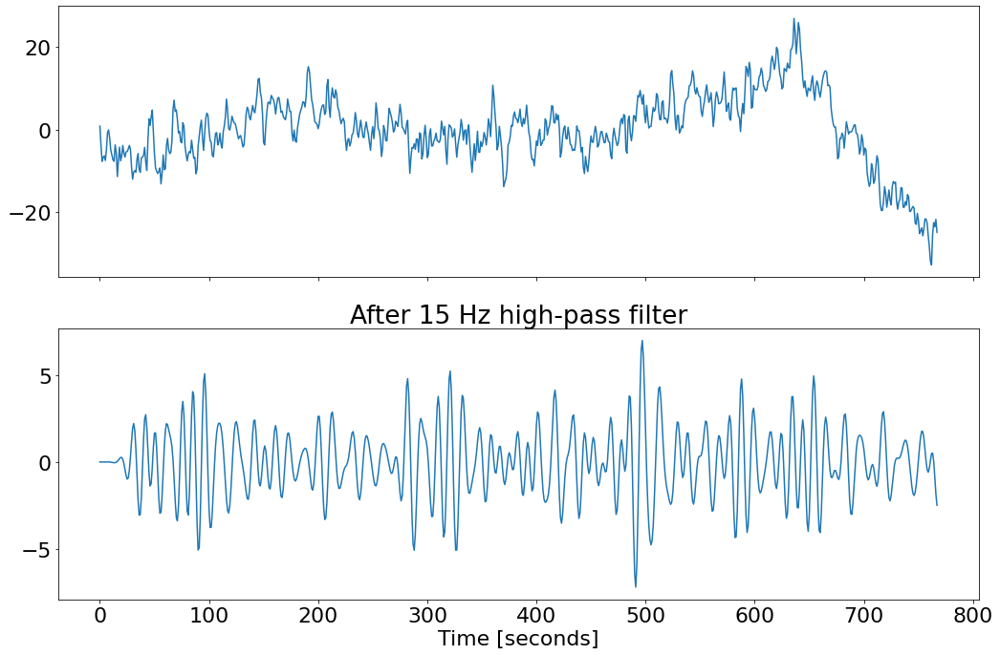

5.49636549062246
5.357046309639262
[24]
[90]


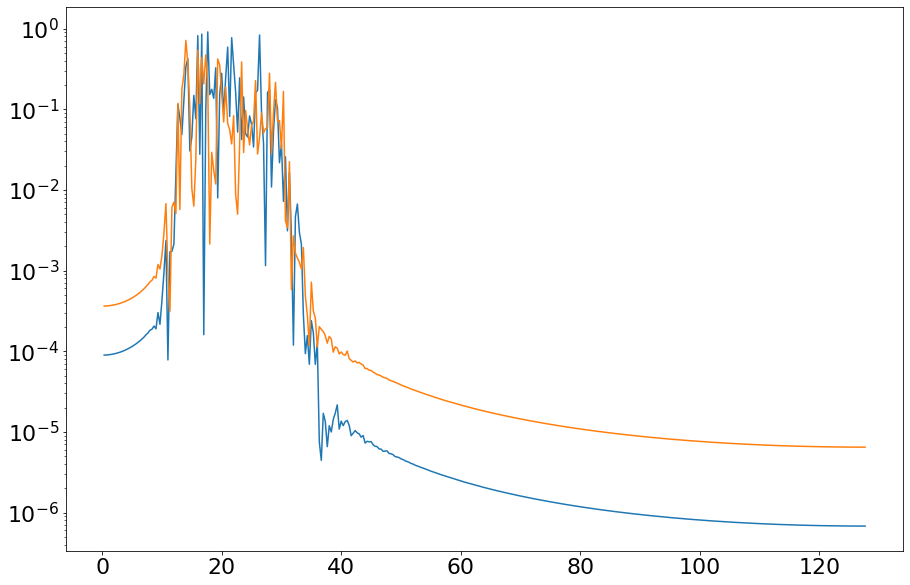

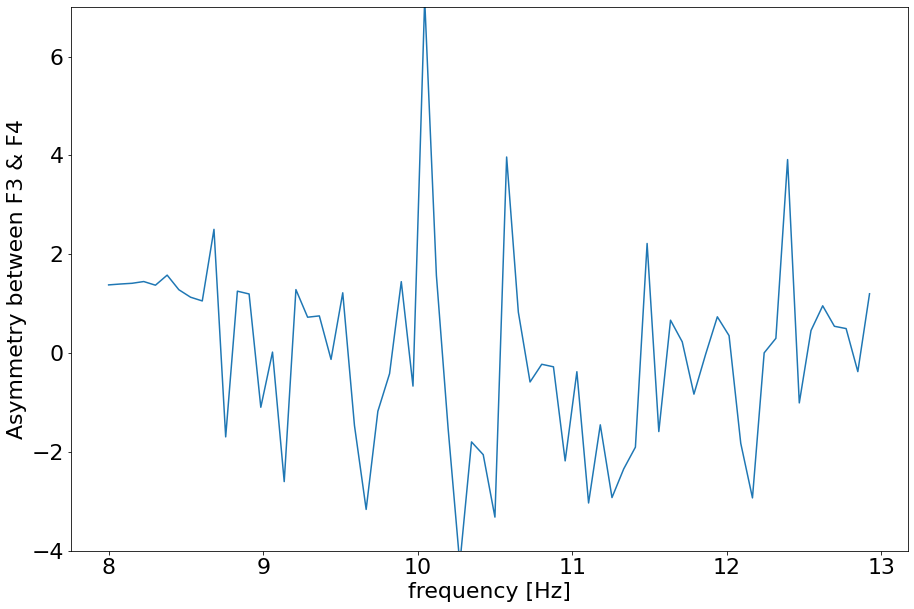

In [508]:
"""
t = np.linspace(0, 1, 256, False)  # 1 second
sig = np.sin(2*np.pi*10*t) + np.sin(2*np.pi*20*t)
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
ax1.plot(t, sig)
ax1.set_title('10 Hz and 20 Hz sinusoids')
ax1.axis([0, 1, -2, 2])
"""
fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
sig = total_mean_dis[:,4]
sig_2 = total_mean_dis[:,39]
ax1.plot(sig)
#filtrated with bandpass filter at 3–30 Hz. EEG signal
f_s=256
sos = signal.butter(10, [13,30], 'band', fs=f_s, output='sos')
filtered_f3 = signal.sosfilt(sos, sig)
filtered_f4 = signal.sosfilt(sos, sig_2)
ax2.plot(filtered)
ax2.set_title('After 15 Hz high-pass filter')
ax2.set_xlabel('Time [seconds]')
plt.tight_layout()
plt.show()



# EEG segments with amplitudes exceeding ±80 μV were removed. 
print(np.max(filtered_f4))
print(np.max(filtered_f3))

#The power spectrum (μV2/Hz) of all segments was calculated using the Fast Fourier transformation and averaged for each condition.
f, pxx_f3 = signal.periodogram(filtered_f3, f_s)
plt.semilogy(f[1:-1], pxx_f3[1:-1])

f, pxx_f4 = signal.periodogram(filtered_f4, f_s)
plt.semilogy(f[1:-1], pxx_f4[1:-1])

#Spectral power (μV2) at the alpha range (8–13 Hz) was exported
print(np.where(f==8)[0])
start = int(np.where(f==8)[0])
print(np.where(f==30)[0])
stop = int(np.where(f==30)[0])

sub_f3 = pxx_f3[start:stop]
sub_f4 = pxx_f4[start:stop]

# Finally, alpha power of EEG electrodes F3 and F4 was log-transformed and the asymmetry score 
#of frontal alpha was calculated by subtracting the value at F3 from the value at F4
plt.rcParams["figure.figsize"] = (15,10)
plt.figure(5)
plt.plot(np.arange(8,13,5/66),np.log(sub_f4)-np.log(sub_f3))
plt.ylim(-4,7)
plt.xlabel("frequency [Hz]")
plt.ylabel("Asymmetry between F3 & F4")
plt.savefig("asymmetry_test_dis")

39
40
41
(385,)
[  0.           0.33333333   0.66666667   1.           1.33333333
   1.66666667   2.           2.33333333   2.66666667   3.
   3.33333333   3.66666667   4.           4.33333333   4.66666667
   5.           5.33333333   5.66666667   6.           6.33333333
   6.66666667   7.           7.33333333   7.66666667   8.
   8.33333333   8.66666667   9.           9.33333333   9.66666667
  10.          10.33333333  10.66666667  11.          11.33333333
  11.66666667  12.          12.33333333  12.66666667  13.
  13.33333333  13.66666667  14.          14.33333333  14.66666667
  15.          15.33333333  15.66666667  16.          16.33333333
  16.66666667  17.          17.33333333  17.66666667  18.
  18.33333333  18.66666667  19.          19.33333333  19.66666667
  20.          20.33333333  20.66666667  21.          21.33333333
  21.66666667  22.          22.33333333  22.66666667  23.
  23.33333333  23.66666667  24.          24.33333333  24.66666667
  25.          25.33333333  25.666

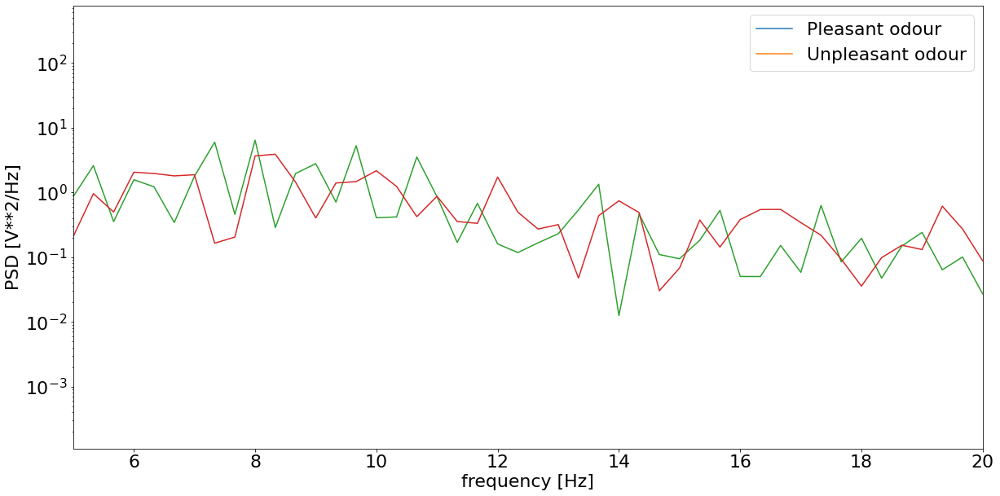

In [246]:
f_s=256
plt.figure(1)
plt.plot(total_mean_ple[:,1])
plt.plot(total_mean_dis[:,1])
max_f_ple = np.zeros(total_mean_ple.shape[1])
spectra_ple = np.zeros(385)
spectra_dis = np.zeros(385)
#39,42
#4,7
for i in range(39,42):
    print(i)
    f, Pxx_den_ple = signal.periodogram(total_mean_ple[:,i], f_s)
    #plt.semilogy(f[1:-1], Pxx_den_ple[1:-1])
    max_f = f[np.argmin(Pxx_den_ple[1:])]
    max_f_ple[i] = max_f
    f, Pxx_den_dis = signal.periodogram(total_mean_dis[:,i], f_s)
    #plt.semilogy(f[1:-1], Pxx_den_dis[1:-1])
    #plt.semilogy(f[1:-1], Pxx_den_dis[1:-1]-Pxx_den_ple[1:-1])
    spectra_ple +=Pxx_den_ple
    spectra_dis +=Pxx_den_dis
plt.figure(1)
print(spectra_ple.shape)
plt.semilogy(f[1:-1], spectra_ple[1:-1]/3)
plt.semilogy(f[1:-1], spectra_dis[1:-1]/3)
print(f)
plt.xlim(5,20)    
plt.xlabel('frequency [Hz]')
plt.ylabel('PSD [V**2/Hz]')
plt.legend(["Pleasant odour", "Unpleasant odour"])
r, p = stats.pearsonr(spectra_ple[20:30]/3, spectra_dis[20:30]/3)
print(r)
#plt.savefig("alpha_left")

# Compare Z

Scipy computed Pearson r: -0.010546842928108691 and p-value: 0.770428286853028 for graph 0
Scipy computed Pearson r: 0.04654566592466059 and p-value: 0.3623923408410695 for fourier spectra 0
Scipy computed Pearson r: -0.008504159233431594 and p-value: 0.8139801196164563 for graph 1
Scipy computed Pearson r: 0.04654566592466059 and p-value: 0.3623923408410695 for fourier spectra 1
Scipy computed Pearson r: -0.014029899616715547 and p-value: 0.6978726288090332 for graph 2
Scipy computed Pearson r: 0.04654566592466059 and p-value: 0.3623923408410695 for fourier spectra 2
Scipy computed Pearson r: -0.003104706824783119 and p-value: 0.9315457349341238 for graph 3
Scipy computed Pearson r: 0.04654566592466059 and p-value: 0.3623923408410695 for fourier spectra 3


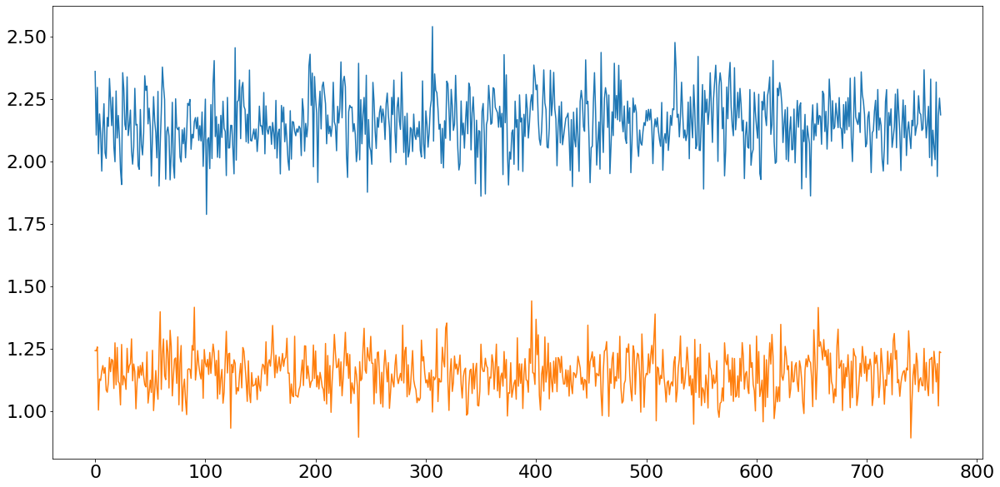

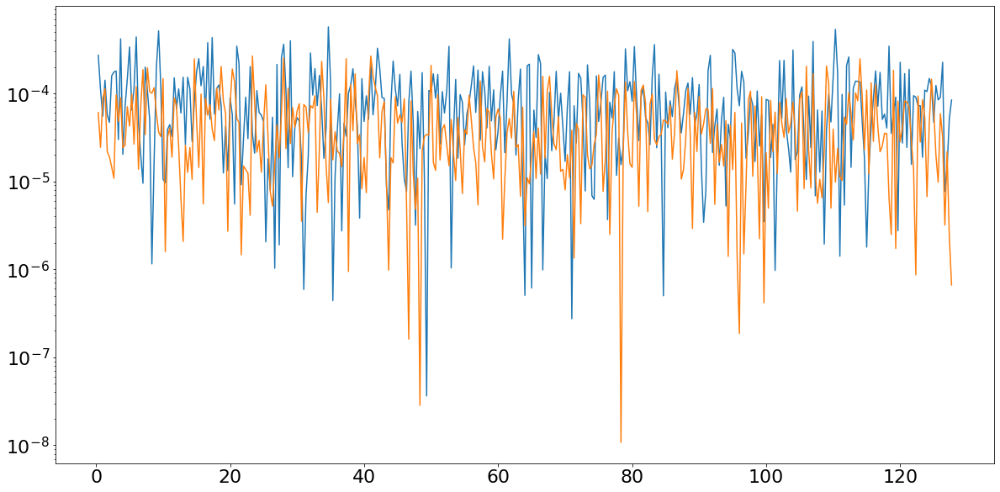

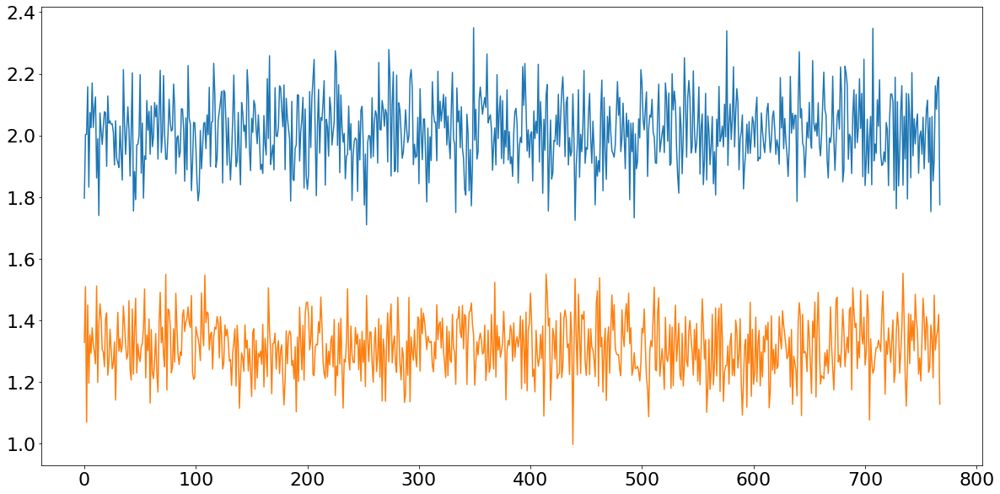

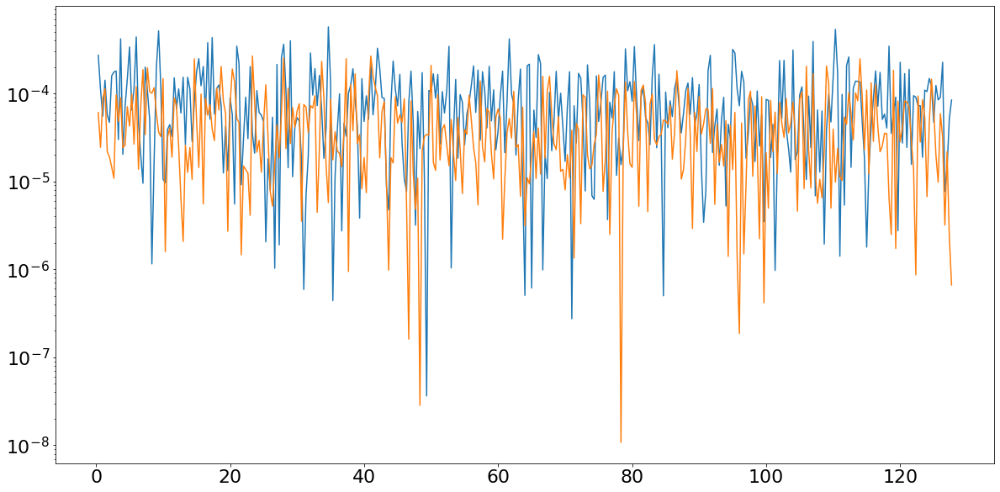

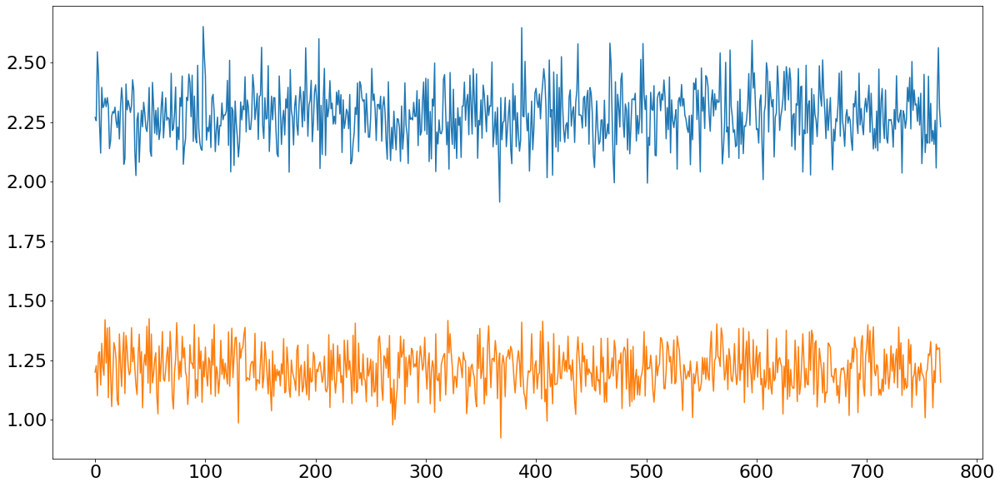

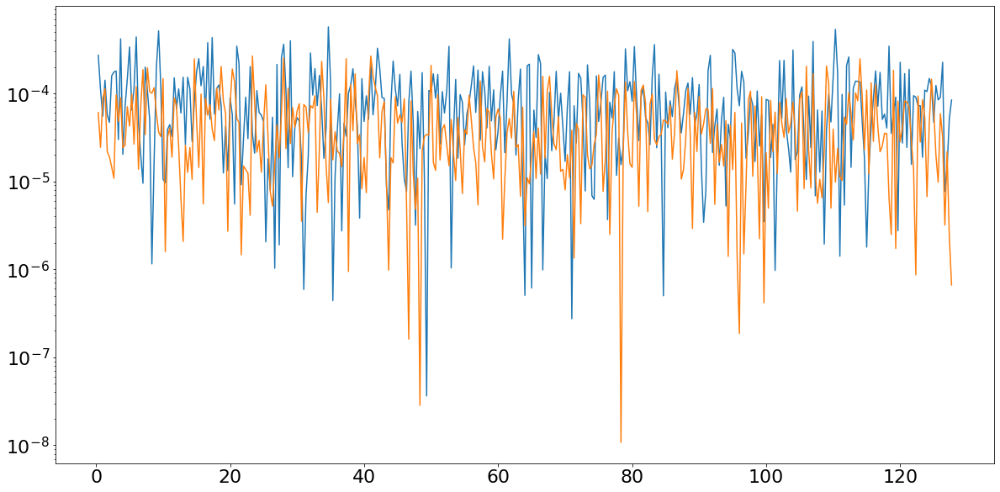

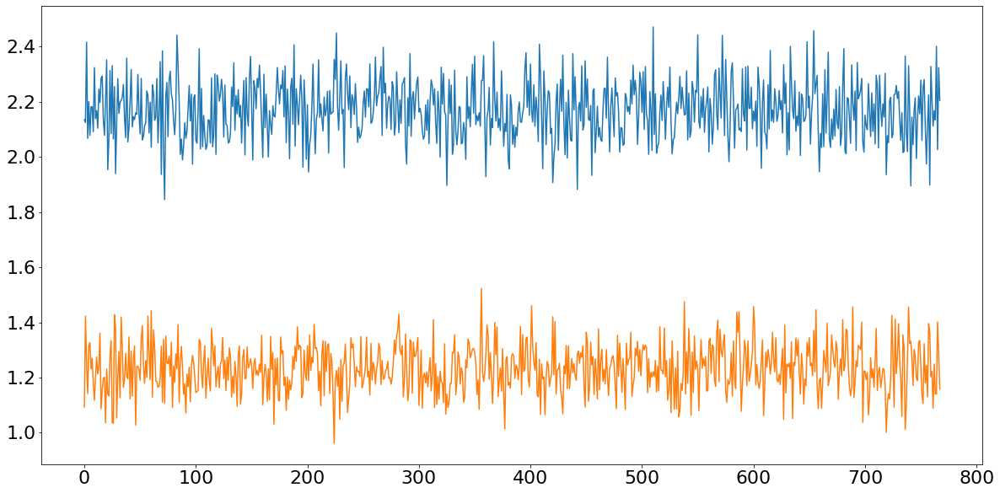

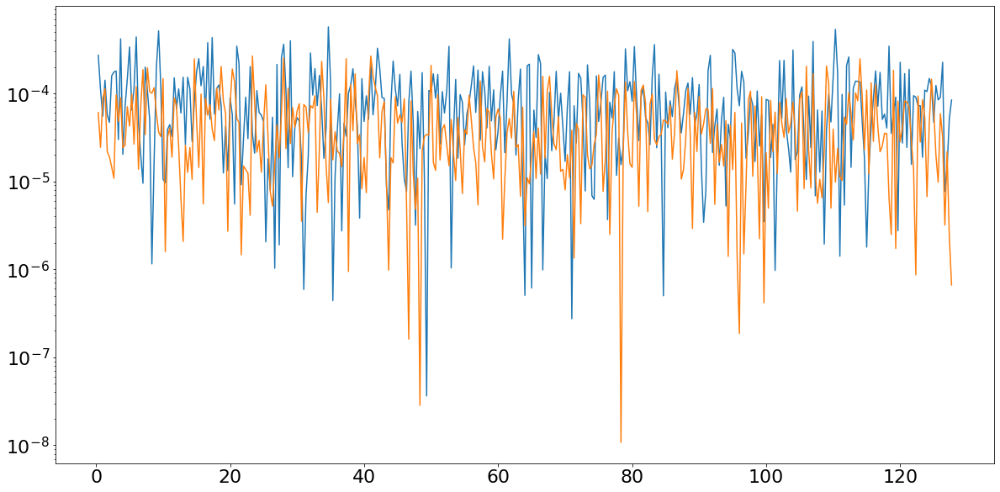

In [479]:
def get_trial_per_participant_4(data,trials_per_participant):
    mean_per_p = np.zeros((19,768,4))
    for i, n in enumerate(trials_per_participant):
        prev = int(np.sum(trials_per_participant[0:i]))
        if n != 0:
            for j in range(int(n)):
                mean_per_p[i] +=data[j+prev]
            mean_per_p[i]/n
    return mean_per_p

z_ple = np.load("z_ple_test_4_100.npy")
z_dis = np.load("z_dis_test_4_100_1000.npy")

mean_ple_z = get_trial_per_participant_4(z_ple,trials_per_participant_ple_test)
total_mean_ple_z = np.mean(mean_ple_z,axis=0)
mean_dis_z = get_trial_per_participant_4(z_dis,trials_per_participant_dis_test)
total_mean_dis_z = np.mean(mean_dis_z,axis=0)

for i in range(total_mean_dis_z.shape[1]):
    plt.figure(i)
    plt.plot(total_mean_ple_z[:,i])
    plt.plot(total_mean_dis_z[:,i])
    plt.figure(10+i)
    r, p = stats.pearsonr(total_mean_ple_z[:,i], total_mean_dis_z[:,i])
    print(f"Scipy computed Pearson r: {r} and p-value: {p} for graph {i}")
    
    f_s = 256  # Sampling rate, or number of measurements per second
    f, Pxx_1 = signal.periodogram(total_mean_ple_z[:,0], f_s)
    plt.semilogy(f[1:-1], Pxx_1[1:-1])
    f, Pxx_2 = signal.periodogram(total_mean_dis_z[:,0], f_s)
    plt.semilogy(f[1:-1], Pxx_2[1:-1])
    r, p = stats.pearsonr(Pxx_1, Pxx_2)
    print(f"Scipy computed Pearson r: {r} and p-value: {p} for fourier spectra {i}" )

(70, 768, 64)
0.9995716781216658
(768, 64)
(70, 768, 64)
0.9991515688058411
(768, 64)
(70, 768, 64)
0.9986085264003401
(768, 64)
(70, 768, 64)
0.9993823532046893
(768, 64)
heh


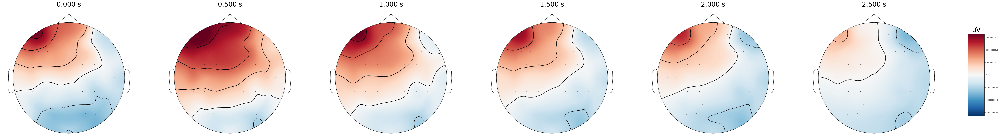

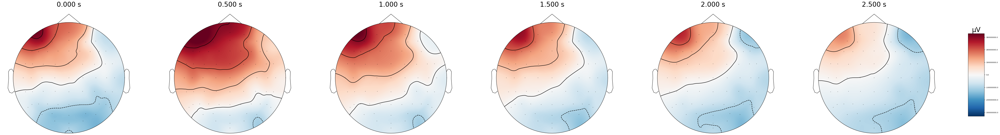

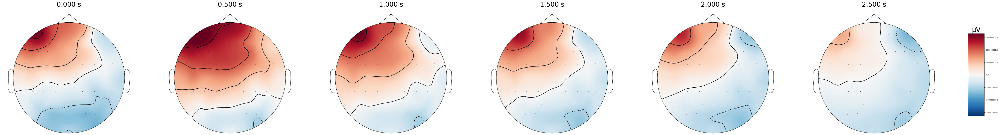

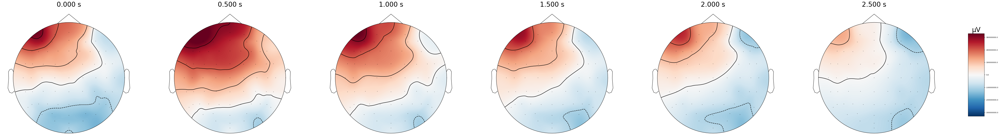

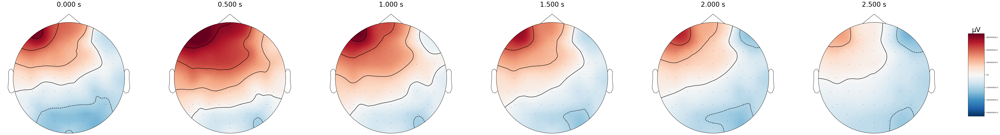

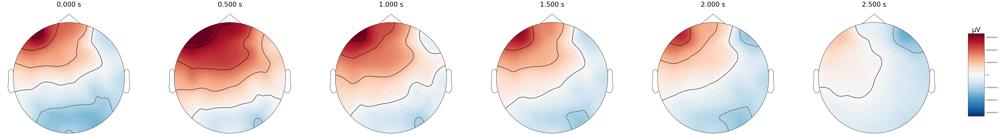

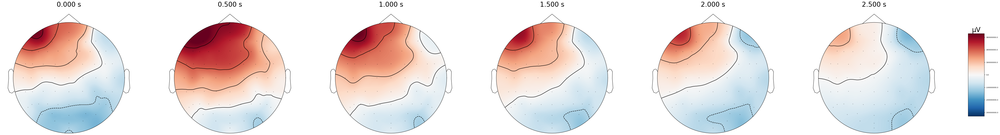

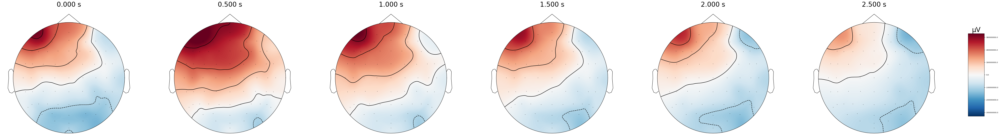

In [480]:
for i in range(4):

    conf = Config()
    x = decode_z(conf,z_dis,i,0,True)
    #plt.plot(x[:,0])
    print(x.shape)

    #print(x.shape)
    all_x = np.zeros((len(x),768,64))
    for j in range(len(x)):

        x_s = test_dis_min_max_scalers[j].inverse_transform(x[j].reshape(1,int(x.shape[1]*x.shape[2]))).reshape(x.shape[1],x.shape[2])
        all_x[j] = x_s
    
    mean_ple = get_trial_per_participant(all_x,trials_per_participant_dis_test)
    total_mean_ple = np.mean(mean_ple,axis=0)
    
    
    x = decode_z(conf,z_dis,i,1,True)

    all_x_2 = np.zeros((len(x),768,64))
    for j in range(len(x)):

        x_s = test_dis_min_max_scalers[j].inverse_transform(x[j].reshape(1,int(x.shape[1]*x.shape[2]))).reshape(x.shape[1],x.shape[2])
        all_x_2[j] = x_s
    #print(x.shape)
    
    mean_ple = get_trial_per_participant(all_x_2,trials_per_participant_dis_test)
    total_mean_ple_2 = np.mean(mean_ple,axis=0)

    #plt.plot(x_arr_mean_2[:,0])
    corr_arr = np.zeros(total_mean_ple.shape[1])
    for j in range(total_mean_ple.shape[1]):
        r, p = stats.pearsonr(total_mean_ple[:,j], total_mean_ple_2[:,j])
        corr_arr[j] = r
    print(np.mean(corr_arr))
    times = np.arange(0, 2.99, 0.5)
    evoked_array = mne.EvokedArray(total_mean_ple.T, info, tmin=0,
                               nave=x_s.shape[0], comment='simulated')
    fig = evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128,show=False)
    plt.savefig("z_dis_4_1"+str(i))
    evoked_array = mne.EvokedArray(total_mean_ple_2.T, info, tmin=0,
                               nave=x_s.shape[0], comment='simulated')
    fig = evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128,show=False)
    f_s = 256  # Sampling rate, or number of measurements per second
    print(total_mean_ple.shape)
    plt.savefig("z_dis_4_2"+str(i))
    #f, Pxx_1 = signal.periodogram(total_mean_ple[:,0], f_s)
    #plt.semilogy(f[1:-1], Pxx_1[1:-1])
    #f, Pxx_2 = signal.periodogram(total_mean_ple_2[:,0], f_s)
    #plt.semilogy(f[1:-1], Pxx_2[1:-1])

print("heh")

(111, 768, 64)
0.9995452550476014


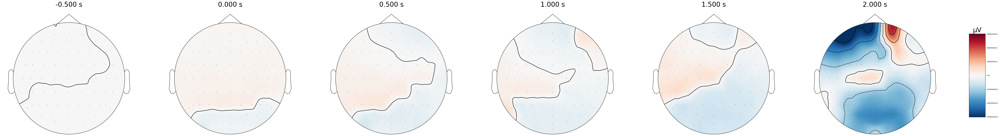

(768, 64)
(111, 768, 64)
0.9989282362316689


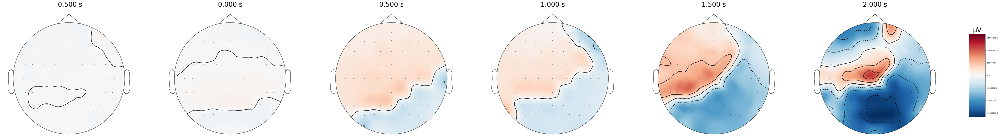

(768, 64)
(111, 768, 64)
0.9989436373489844


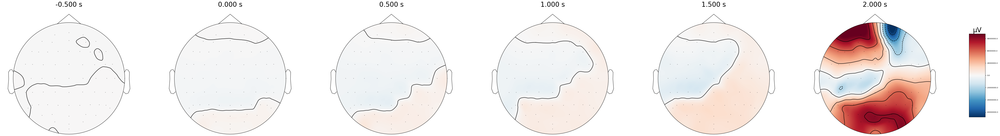

(768, 64)
(111, 768, 64)
0.999331735818744


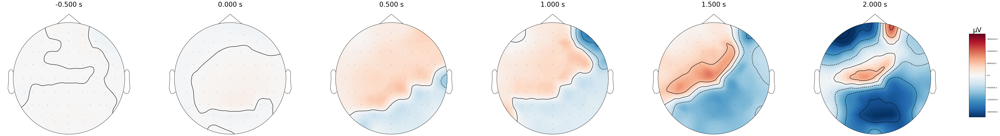

(768, 64)
heh


In [438]:
for i in range(4):

    conf = Config()
    x = decode_z(conf,z_ple,i,0,True)
    #plt.plot(x[:,0])
    print(x.shape)

    #print(x.shape)
    all_x = np.zeros((len(x),768,64))
    for j in range(len(x)):

        x_s = test_ple_min_max_scalers[j].inverse_transform(x[j].reshape(1,int(x.shape[1]*x.shape[2]))).reshape(x.shape[1],x.shape[2])
        all_x[j] = x_s
    
    mean_ple = get_trial_per_participant(all_x,trials_per_participant_ple_test)
    total_mean_ple = np.mean(mean_ple,axis=0)
    
    
    x = decode_z(conf,z_ple,i,1,True)
    with open('scalers_train.pickle','rb') as f:
        scalers = pickle.load(f)

    all_x_2 = np.zeros((len(x),768,64))
    for j in range(len(x)):

        x_s = test_ple_min_max_scalers[j].inverse_transform(x[j].reshape(1,int(x.shape[1]*x.shape[2]))).reshape(x.shape[1],x.shape[2])
        all_x_2[j] = x_s
    #print(x.shape)
    
    mean_ple = get_trial_per_participant(all_x_2,trials_per_participant_ple_test)
    total_mean_ple_2 = np.mean(mean_ple,axis=0)

    #plt.plot(x_arr_mean_2[:,0])
    corr_arr = np.zeros(total_mean_ple.shape[1])
    for j in range(total_mean_ple.shape[1]):
        r, p = stats.pearsonr(total_mean_ple[:,j], total_mean_ple_2[:,j])
        corr_arr[j] = r
    print(np.mean(corr_arr))
    times = np.arange(-0.5, 2.49, 0.5)
    evoked_array = mne.EvokedArray(abs(total_mean_ple.T) -abs(total_mean_ple_2.T), info, tmin=-0.5,
                               nave=x_s.shape[0], comment='simulated')
    evoked_array.plot_topomap(times, ch_type='eeg', time_unit='s',colorbar=True,
                    size=6, res=128)
    f_s = 256  # Sampling rate, or number of measurements per second
    print(total_mean_ple.shape)
    #f, Pxx_1 = signal.periodogram(total_mean_ple[:,0], f_s)
    #plt.semilogy(f[1:-1], Pxx_1[1:-1])
    #f, Pxx_2 = signal.periodogram(total_mean_ple_2[:,0], f_s)
    #plt.semilogy(f[1:-1], Pxx_2[1:-1])

print("heh")

# Cluster

(70, 768, 4)
(181, 768)
(181, 768)
(181, 768)
(181, 768)


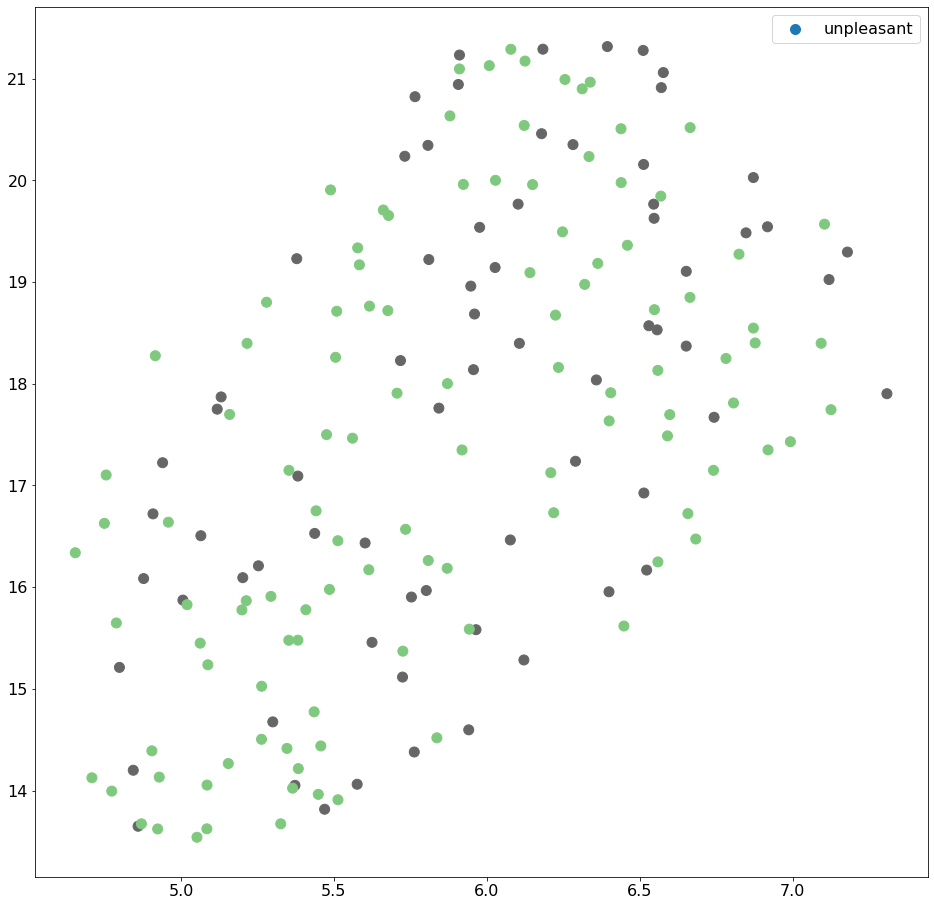

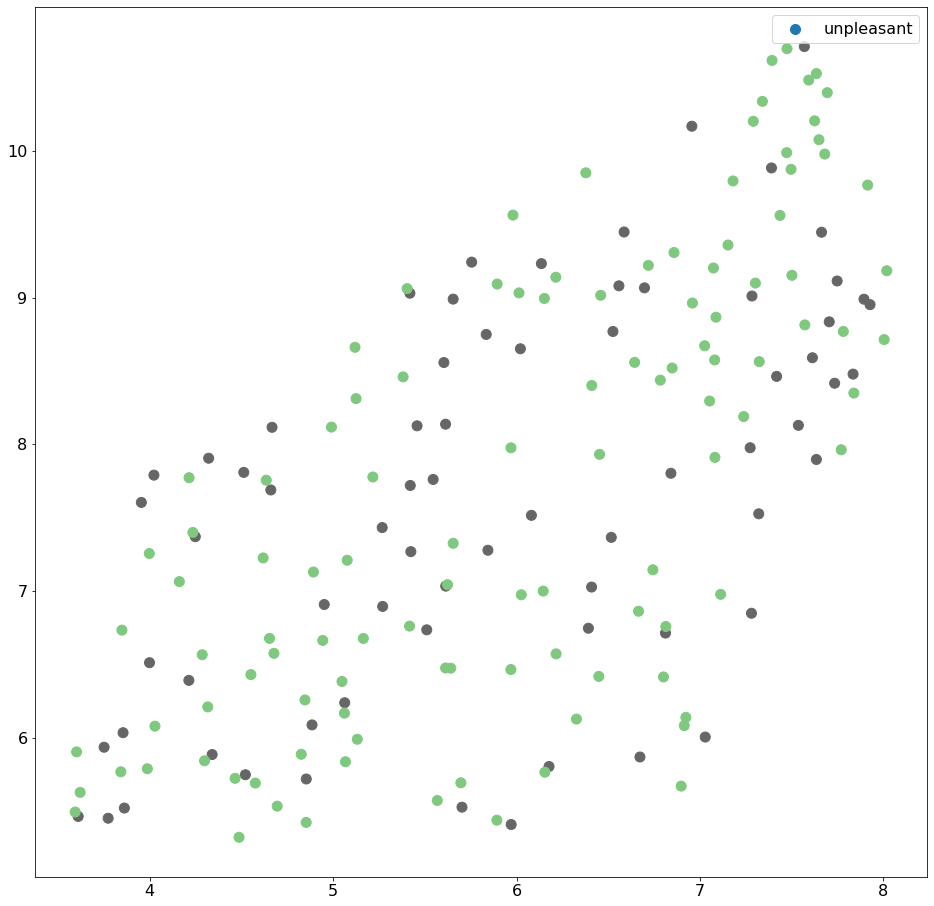

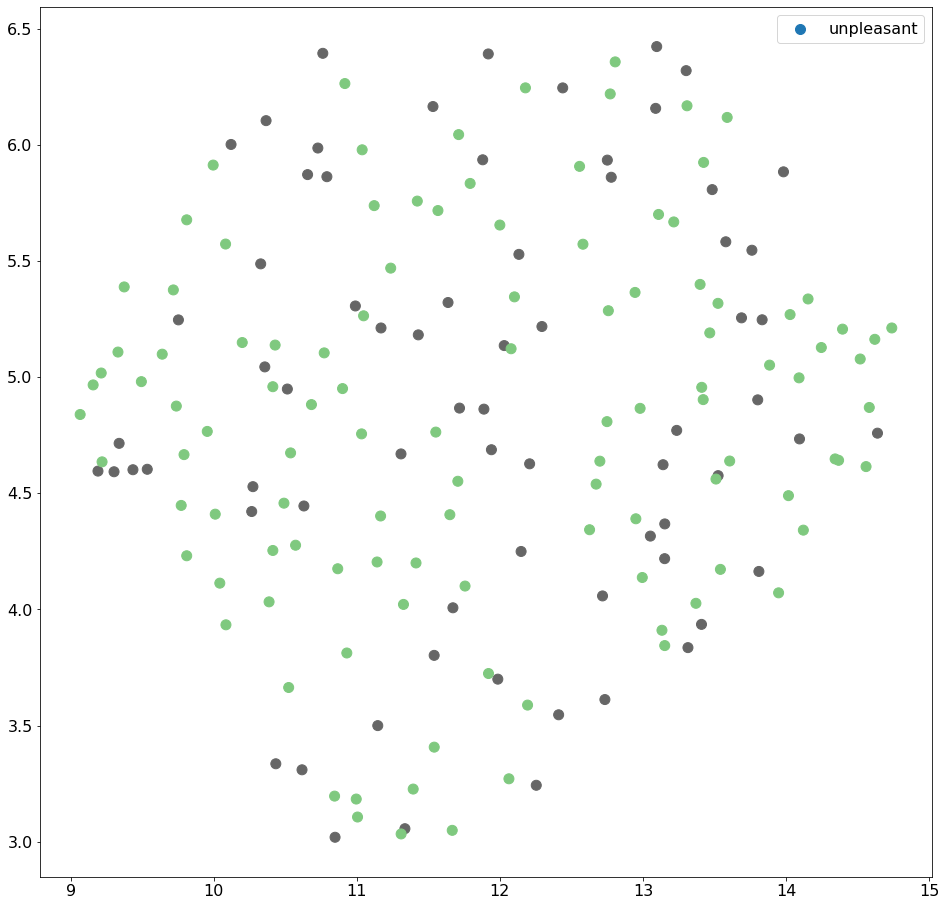

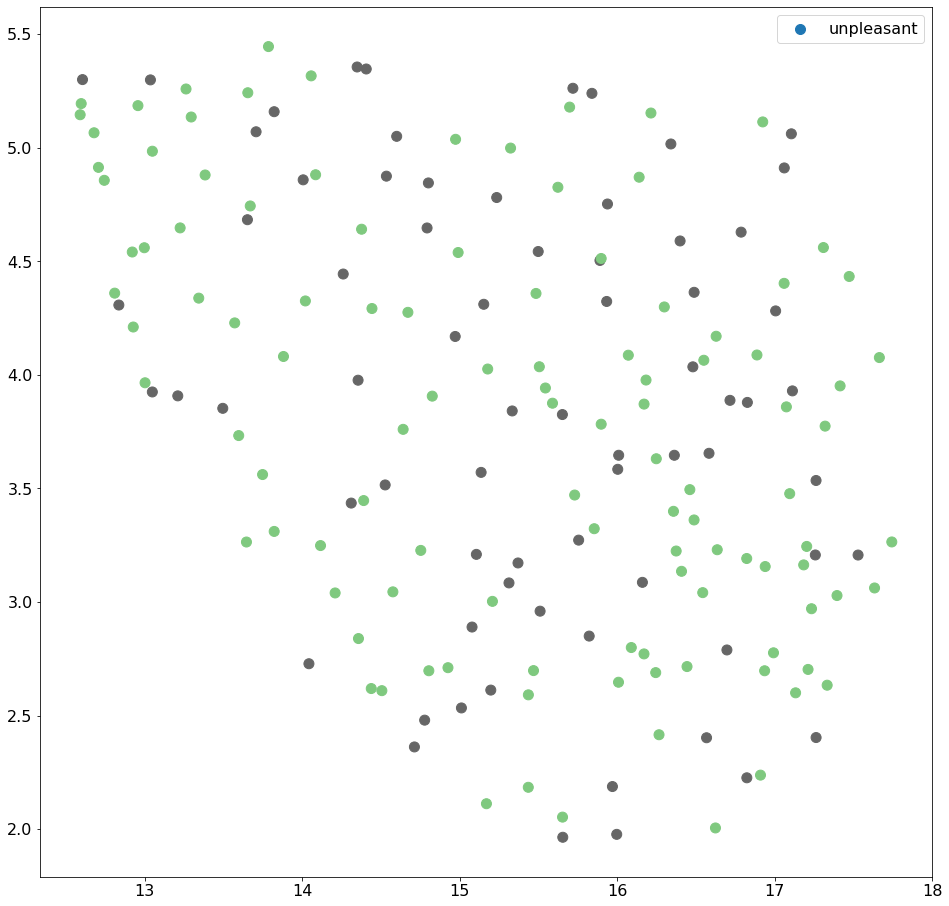

In [531]:
import umap
UMAP_DR = umap.UMAP(n_neighbors=50)


dec_mean_dis = np.load("dec_means_test_data_dis.npy")
#dec_mean_dis = dec_mean_dis.reshape((dec_mean_dis.shape[0],dec_mean_dis.shape[1]))
dec_mean_ple = np.load("dec_means_test_data_ple.npy")
#dec_mean_ple = dec_mean_ple.reshape((dec_mean_ple.shape[0],dec_mean_ple.shape[1]))

print(dec_mean_dis.shape)
l = np.ones(dec_mean_dis.shape[0])
l = np.append(l,np.zeros(dec_mean_ple.shape[0]))
for i in range(dec_mean_dis.shape[2]):
    dec_mean_dis_n = dec_mean_dis[:,:,i]
    dec_mean_ple_n = dec_mean_ple[:,:,i]
    all_data = np.append(dec_mean_dis_n, dec_mean_ple_n,axis=0)
    print(all_data.shape)
    data_DR = UMAP_DR.fit_transform(all_data)
    #print(data_DR)

    fig, ax = plt.subplots(figsize=(16, 16))
    sc = ax.scatter(
        data_DR[:, 0],
        data_DR[:, 1],
        c=l.astype(int),
        cmap="Accent",
        rasterized=True,
        s=100,
    )
    #ax.set_title("VAE 2 classes: Happy & Disgust", fontsize=20)
    plt.legend(["unpleasant", "pleasant"])
    #cbar = plt.colorbar(sc, ax=ax);
    #cbar.ax.set_ylabel('Class label')
    #cbar.set_ticks([])
    plt.savefig("cluster_z_"+str(i))